In [ ]:
# for loading/processing the images
from keras.preprocessing.image import load_img
# from keras.preprocessing.image import img_to_array
# from keras.applications.vgg16 import preprocess_input
# from tensorflow.keras.utils  import load_img
# from tensorflow.keras.utils import img_to_array

# models
from keras.applications.vgg16 import VGG16
# from keras.models import Model

# clustering and dimension reduction
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA

# for everything else
import os
import numpy as np
import matplotlib.pyplot as plt
from random import randint
import pandas as pd
import pickle
import os
from sklearn import metrics

from PIL import Image
import cv2
from yellowbrick.cluster import KElbowVisualizer
import seaborn as sn
import pandas as pd

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
path_imagenes = 'drive/MyDrive/TP 1 DMCyT 2023/natural_images/'
path_repo = 'drive/MyDrive/TP 1 DMCyT 2023/'

#path_imagenes = 'natural_images/'
#path_repo = ''

# Preparación de los datos

## a. Levantar las imágenes y sus etiquetas

In [ ]:
#def get_file_list(path):
#  return sorted([os.path.join(path, file)
#               for file in os.listdir(path )
#               if file.endswith('.jpg')])

#airplanes  = get_file_list(path_imagenes+'airplane/')
#cars       = get_file_list(path_imagenes+'car/')
#dog        = get_file_list(path_imagenes+'dog/')
#flowers    = get_file_list(path_imagenes+'flower/')
#fruits     = get_file_list(path_imagenes+'fruit/')
#motorbikes = get_file_list(path_imagenes+'motorbike/')
#persons    = get_file_list(path_imagenes+'person/')
#cats       = get_file_list(path_imagenes+'cat/')

In [ ]:
#importamos features procesadas
features = pd.read_pickle(path_repo+'PICKLE/features.pkg')
features['path'] = path_imagenes+features.label+'/'+features.index+'.jpg'

# move columns to front
cols = list(features)
cols.insert(0, cols.pop(cols.index('path')))
cols.insert(1, cols.pop(cols.index('label')))
features = features.loc[:, cols]
features.head()

,path,label,0,1,2,3,4,5,6,7,...,4086,4087,4088,4089,4090,4091,4092,4093,4094,4095
cat_0000,drive/MyDrive/TP 1 DMCyT 2023/natural_images/c...,cat,0.0,0.000000,2.515398,4.019900,0.000000,0.000000,1.027829,0.0,...,0.000000,0.0,0.0,0.000000,0.000000,2.857614,0.000000,0.0,0.000000,0.923190
cat_0001,drive/MyDrive/TP 1 DMCyT 2023/natural_images/c...,cat,0.0,0.452876,2.722886,0.000000,0.000000,0.000000,2.052442,0.0,...,0.000000,0.0,0.0,0.000000,2.265065,0.226556,0.000000,0.0,3.954550,0.000000
cat_0002,drive/MyDrive/TP 1 DMCyT 2023/natural_images/c...,cat,0.0,0.000000,3.336025,4.876245,0.000000,0.000000,2.215467,0.0,...,0.000000,0.0,0.0,0.000000,0.000000,4.603654,3.077219,0.0,0.000000,1.297259
cat_0003,drive/MyDrive/TP 1 DMCyT 2023/natural_images/c...,cat,0.0,0.000000,1.998834,0.000000,0.756383,0.754227,0.000000,0.0,...,2.240983,0.0,0.0,0.106895,1.212844,0.000000,0.000000,0.0,0.000000,0.573255
cat_0004,drive/MyDrive/TP 1 DMCyT 2023/natural_images/c...,cat,0.0,0.000000,1.689797,1.770785,1.249804,0.000000,3.327176,0.0,...,0.000000,0.0,0.0,0.000000,0.173968,1.202688,0.000000,0.0,2.267211,0.666602


## b. Documentar las propiedades del dataset a utilizar

## c. Describir sus atributos, de forma semejante a lo realizado en el pre-informe.

In [ ]:
def threshold_image(image):
    # Apply thresholding to the input image
    ret, thresholded_image = cv2.threshold(image, 127, 255, cv2.THRESH_BINARY)
    return thresholded_image

def average_img_3(imlist, byn=False):
    if byn:
        images = np.array([threshold_image(cv2.imread(fname, cv2.THRESH_BINARY)) for fname in imlist])
    else:
        images = np.array([cv2.resize(cv2.cvtColor(cv2.imread(fname), cv2.COLOR_BGR2RGB), (224, 224)) for fname in imlist])
    # Alternative method using numpy mean function
    arr = np.array(np.mean(images, axis=(0)), dtype=np.uint8)
    out = Image.fromarray(arr)
    return out

In [ ]:
def average_img_hist(path):
    # Alternative method using numpy mean function
    images = np.array([cv2.resize(cv2.cvtColor(cv2.imread(fname), cv2.COLOR_BGR2RGB), (224, 224)) for fname in path])
    arr = np.array(np.mean(images, axis=(0)), dtype=np.uint8)
    return arr

def pixel_hist(path):

    fig, ax = plt.subplots(1,2,figsize=(12,5))

    ax[0].hist(average_img_hist(path).ravel(),color='gray',edgecolor='k');

    colores =['red','green','blue']
    for n,cs in enumerate(colores):
        monocol=average_img_hist(path)[:,:,n]
        ax[1].hist(monocol.flatten(),color=cs,bins=range(0,224,10),edgecolor='k',alpha=0.5,label=cs)
        ax[1].legend()

    # plt.suptitle('Análisis de píxeles: promedio general');

### Imagen Promedio por categoria (en un solo plot)

In [ ]:
# Initialize a dictionary to store average images for each label
average_images = {}

# Iterate through each group
for label in features['label'].unique():
    # Get the group dataframe
    group = features[features['label'] == label]
    # Extract image paths for the current group
    image_paths = group['path'].tolist()

    # Calculate the average image for the group
    avg_image = average_img_3(image_paths)

    # Store the average image in the dictionary with the label as the key
    average_images[label] = avg_image

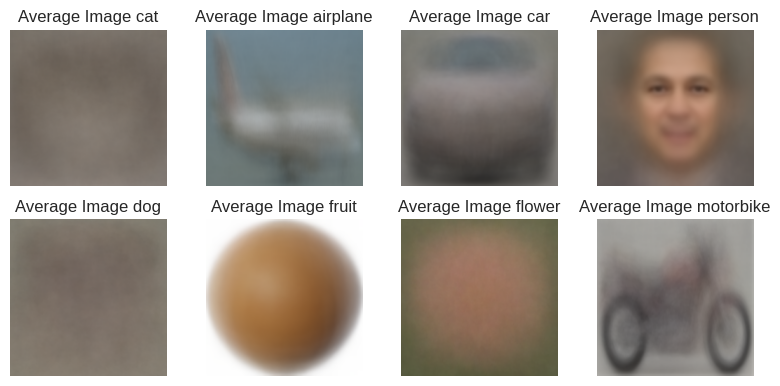

In [ ]:
#La parte del plot lo deje separado porque demora bastante calcular el promedio por imagenes (15-20minutos).
#Asi hacer algun cambio en el "ploteo" no requiere procesar de nuevo los promedios
# Create a figure and an array of subplots
fig, axs = plt.subplots(2, 4, figsize=(8, 4))
axs = axs.ravel()

for i, (label, avg_image) in enumerate(average_images.items()):
    axs[i].imshow(avg_image)
    axs[i].set_title(f"Average Image {label}")
    axs[i].axis('off')

plt.tight_layout()
plt.savefig('promedio_categoria.png')
#plt.savefig(path_repo+'promedio_categoria.png')
plt.show()

### Histogramas por categoria (en un solo plot)

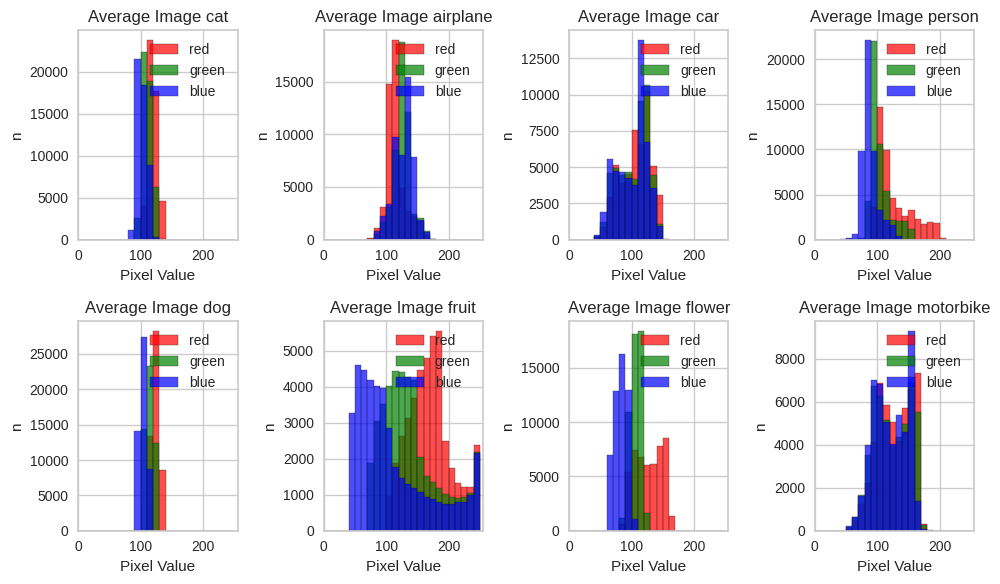

In [ ]:
fig, axs = plt.subplots(2, 4, figsize=(10, 6))
axs = axs.ravel()

colores = ['red', 'green', 'blue']

for i, (label, avg_image) in enumerate(average_images.items()):
    for channel, color in enumerate(colores):
        channel_data = np.array(avg_image)[:, :, channel].flatten()
        axs[i].hist(channel_data, bins=range(0,255, 10), color=color, edgecolor='k', alpha=0.7, label=color)
    axs[i].set_title(f"Average Image {label}")
    axs[i].legend(loc='upper right')  # Add a legend to distinguish channels
    axs[i].set_xlabel('Pixel Value')
    axs[i].set_ylabel('n')
    axs[i].set_xlim(0,255) #Deje de este tamaño para poder comparar todos los histogramas al estar todos "en la misma escala"

plt.tight_layout()
plt.savefig('hist_per_category.png')
#plt.savefig(path_repo+'hist_per_category.png')
plt.show()

# Extracción de características features

Se propone el uso de un modelo de redes neuronales convolucionales que es muy utilizado en el campo de la visión. VGG16, es un modelo de Transfer Learning que posee 16 capas (con pesos) pre entrenado para clasificación de imágenes. Dicho modelo está implementado en [Keras](https://keras.io/api/applications/vgg/) y por default trabaja con imágenes de 224x224.

Este modelo es entrenado de forma supervisada para clasificación y aprende en las capas intermedias características que son relevante para dicha tarea. En el presente trabajo les proponemos utilizar estas características utilizando la salida de las capas intermdias.

Siguiendo los pasos descriptos en las clases, explorar el output del modelo y documentar el proceso y las características del mismo.

In [ ]:
#model = VGG16()
#model = Model(inputs = model.inputs, outputs = model.layers[-2].output)

In [ ]:
def extract_features(file, model):
    # levanta imagen como array 224x224
    img = load_img(file, target_size=(224,224))
    # convierte img a numpy array (originalmente es 'PIL.Image.Image')
    img = np.array(img)
    # reshape para tener formato necesario para el modelo (num_of_samples, dim 1, dim 2, channels)
    reshaped_img = img.reshape(1,224,224,3)
    # prepara imagen para modelo (función de keras)
    imgx = preprocess_input(reshaped_img)
    # extrae features
    features = model.predict(imgx, use_multiprocessing=True)
    return features

In [ ]:
def preprocess(lista, model):
    datays = {}
    for i in lista:
      featuress = extract_features(i, model)
      datays[i] = featuress
    # lista de filenames
    filenmss = np.array(list(datays.keys()))

    # lista de features
    featsss = np.array(list(datays.values()))

    # reshape 4096 features por el número de imagens
    print(featsss.shape)
    featsss = featsss.reshape(-1,4096)
    return filenmss, featsss

In [ ]:
# def save_dataframe(path,nombre_archivo):
# # Levanta archivos y extrae features
#   names, feat = preprocess(path, model)
#   index = [elemento.split("/")[-1] for elemento in names]
#   df = pd.DataFrame(feat,index=[elemento.split(".")[0] for elemento in index])
#   df.to_csv('drive/MyDrive/TP 1 DMCyT 2023/CSV/'+nombre_archivo+'.csv')
#   df.to_pickle('drive/MyDrive/TP 1 DMCyT 2023/PICKLE/'+nombre_archivo+'.pkg')
#   return df

In [ ]:
# cars_ft       = save_dataframe(cars,'cars')
# airplanes_ft  = save_dataframe(airplanes,'airplanes')
# dog_ft        = save_dataframe(dog,'dogs')
# flowers_ft    = save_dataframe(flowers,'flowers')
# fruits_ft     = save_dataframe(fruits,'fruits')
# motorbikes_ft = save_dataframe(motorbikes,'motorbikes')
# persons_ft    = save_dataframe(persons,'persons')
# cats_ft    = save_dataframe(cats,'cats')

In [ ]:
# features = pd.concat((cats_ft,airplanes_ft,cars_ft,persons_ft,dogs_ft,
#                       fruits_ft,flowers_ft,motorbikes_ft),axis=0)
# features['label'] = [fila.split('_')[0] for fila in features.index]
# features.to_pickle(path_repo+'PICKLE/features.pkg')

# Clustering

## Kmeans

### a. Aplicar KMeans sobre el conjuntos de datos (con distintas métricas, normalizaciones, combinaciones, etc). Determinar la cantidad de clusters utilizando silhuette y SSE

In [ ]:
#Para guardar todas las matrices en un diccionario para luego verlas individualmente
n_clusters = [2,3,4,5,6,7,8]

kmeans_models = {}
matriz_confusion = {}

for k in n_clusters:
  model = KMeans(n_clusters=k, n_init=10, random_state=42)
  labels = model.fit_predict(features.drop(columns=['path','label']))
  kmeans_models[f'k_{k}'] = model
  confusion_matrix = pd.crosstab(labels, features['label'], rownames=['clusters'])
  matriz_confusion[f'matriz_confusion_{k}'] = confusion_matrix

In [ ]:
#elegir que matriz ver
matriz_confusion_k = 6
matriz_confusion[f'matriz_confusion_{matriz_confusion_k}']

label,airplane,car,cat,dog,flower,fruit,motorbike,person
clusters,,,,,,,,
0,0,0,0,0,0,0,786,0
1,0,0,844,5,1,0,0,0
2,6,1,41,695,840,12,1,986
3,0,0,0,0,0,985,0,0
4,0,966,0,0,0,0,1,0
5,721,1,0,2,2,3,0,0


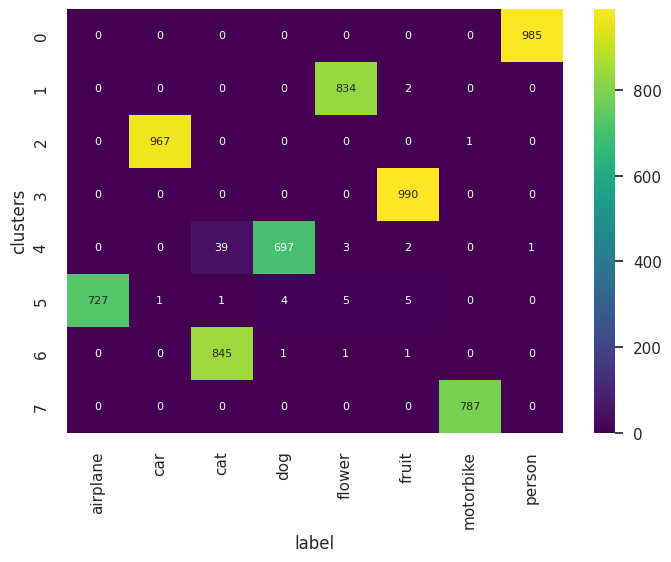

In [ ]:
matriz_confusion_k = 8

df_conf = matriz_confusion[f'matriz_confusion_{matriz_confusion_k}']

# plt.figure(figsize=(10,7))
sn.set(font_scale=1) # for label size
sn.heatmap(df_conf, annot=True, annot_kws={"size": 8}, cmap = 'viridis',fmt='g') # font size
plt.savefig('matriz_conf_8.png')
plt.show()

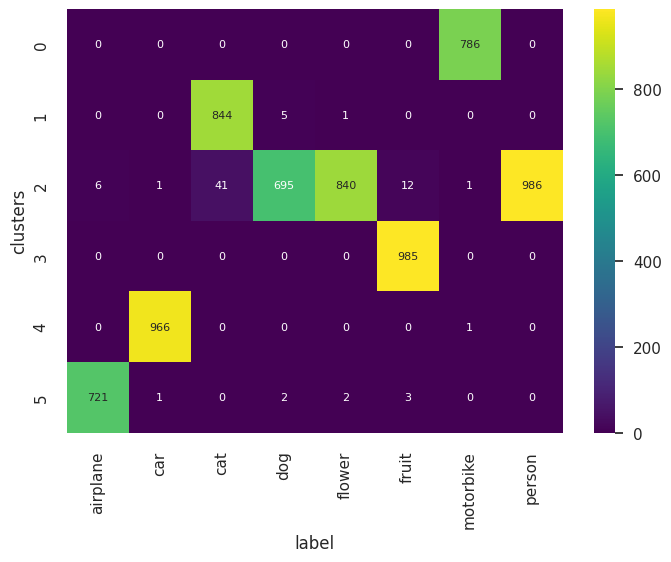

In [ ]:
matriz_confusion_k = 6

df_conf = matriz_confusion[f'matriz_confusion_{matriz_confusion_k}']

# plt.figure(figsize=(10,7))
sn.set(font_scale=1) # for label size
sn.heatmap(df_conf, annot=True, annot_kws={"size": 8}, cmap = 'viridis',fmt='g') # font size
plt.savefig('matriz_conf_6.png')
plt.show()

#### Silhoutte en plots diferentes

For n_clusters = 2 The average silhouette_score is : 0.08026528


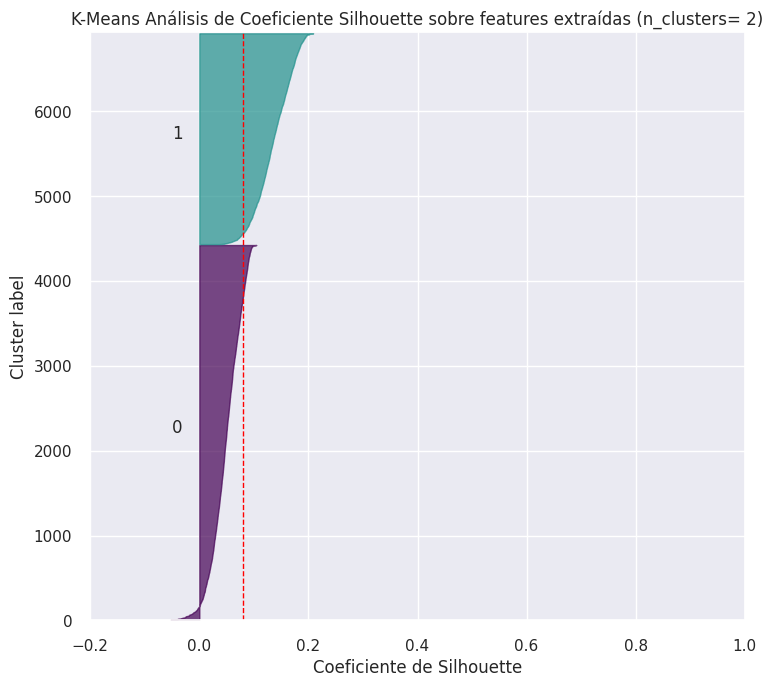

For n_clusters = 3 The average silhouette_score is : 0.10226797


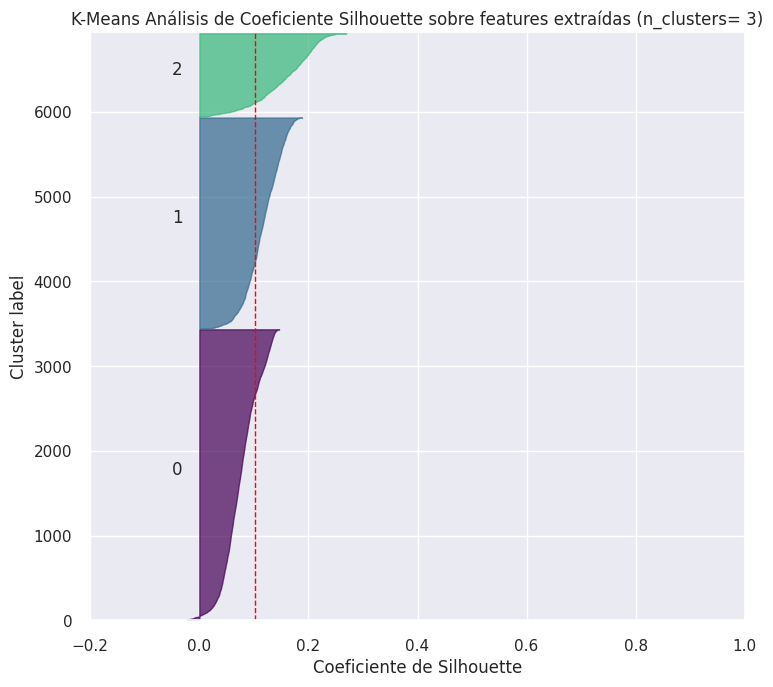

For n_clusters = 4 The average silhouette_score is : 0.1132669


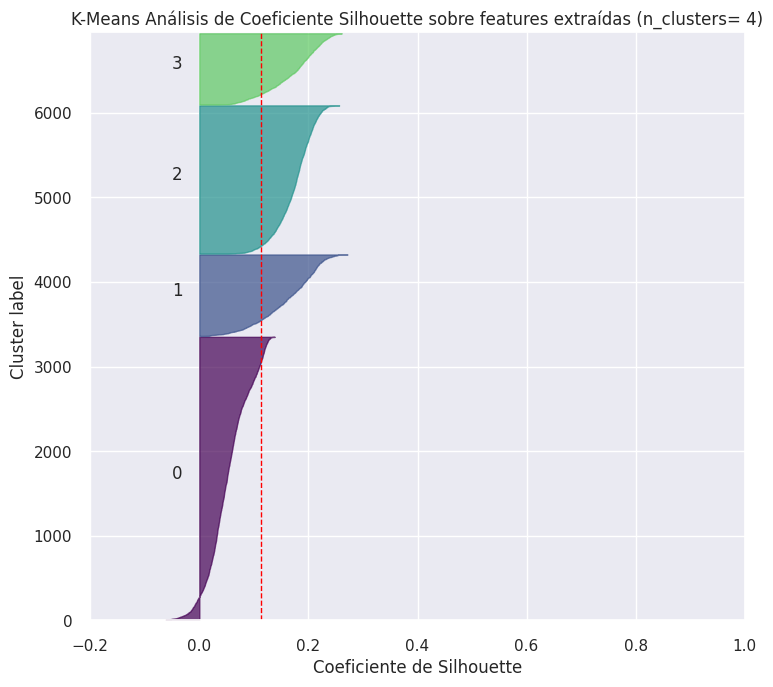

For n_clusters = 5 The average silhouette_score is : 0.08585094


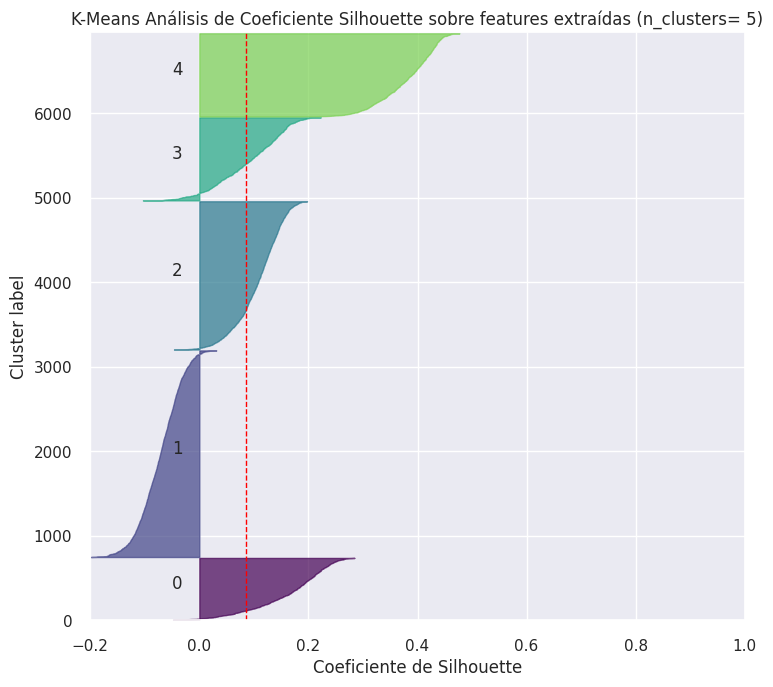

For n_clusters = 6 The average silhouette_score is : 0.1437493


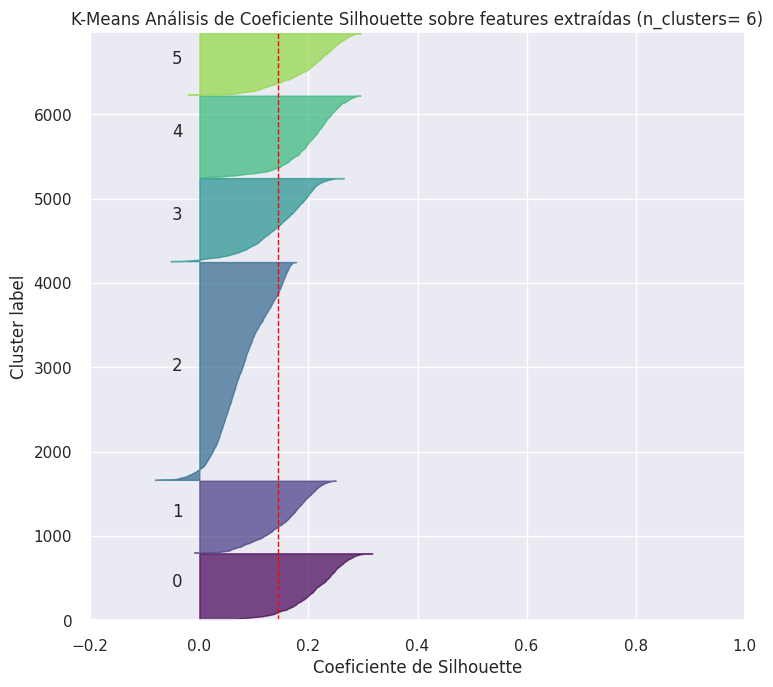

For n_clusters = 7 The average silhouette_score is : 0.12785858


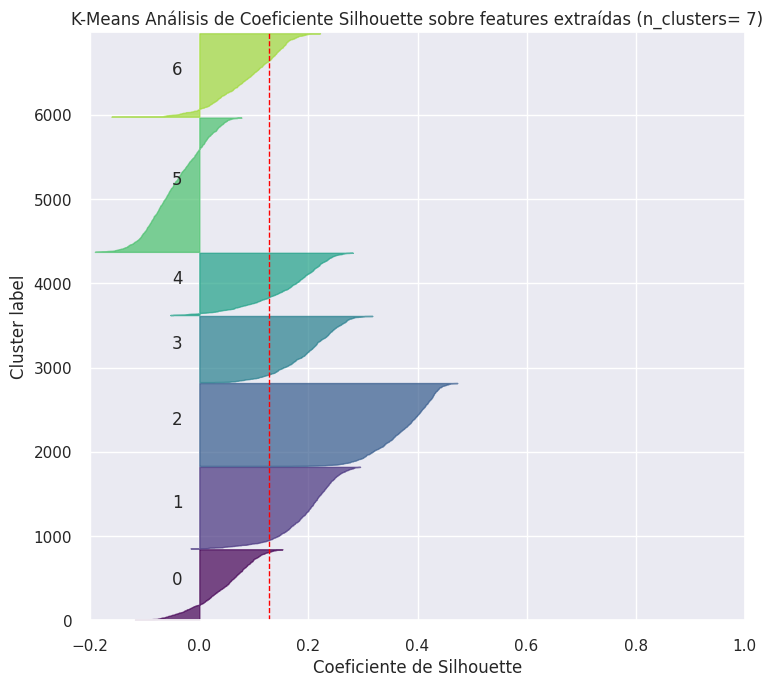

For n_clusters = 8 The average silhouette_score is : 0.14274028


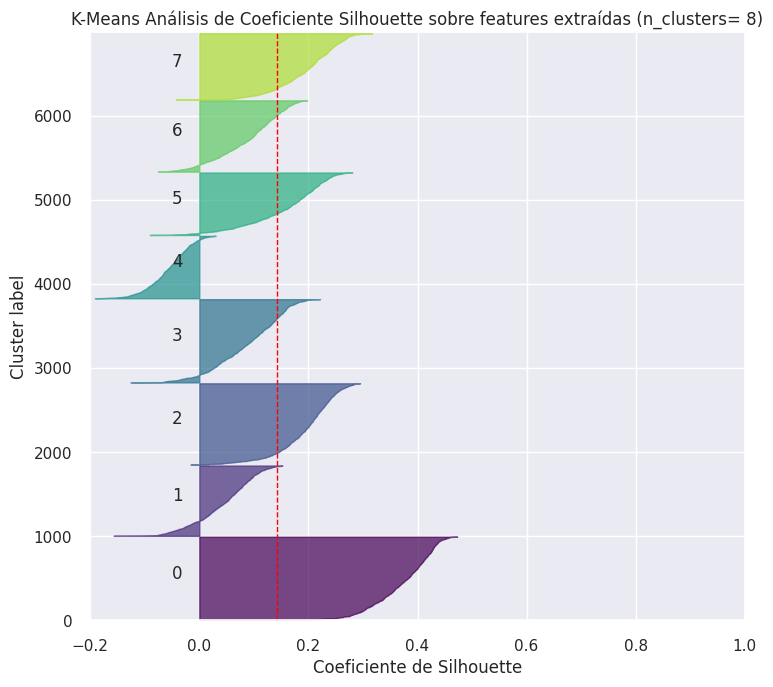

In [ ]:
from sklearn.metrics import silhouette_score, silhouette_samples

# Generate some sample data
X = np.array(features.drop(columns=['path','label']))

range_n_clusters = [2, 3, 4, 5, 6, 7, 8]

for n_clusters in range_n_clusters:
    plt.figure(figsize=(15, 7))
    plt.subplots_adjust(left=0.02, right=0.98, top=0.94, bottom=0.1)

    plt.subplot(1, 2, 1)
    plt.xlim([-0.2, 1])
    plt.ylim([0, len(X) + (n_clusters + 1) * 10])

    cluster_labels = kmeans_models[f'k_{n_clusters}'].labels_

    silhouette_avg = silhouette_score(X, cluster_labels)
    print("For n_clusters =", n_clusters,
          "The average silhouette_score is :", silhouette_avg)

    sample_silhouette_values = silhouette_samples(X, cluster_labels)
    y_lower = 10

    for i in range(n_clusters):
        ith_cluster_silhouette_values = sample_silhouette_values[cluster_labels == i]
        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        colors = plt.cm.viridis(float(i) / n_clusters)
        plt.fill_betweenx(np.arange(y_lower, y_upper),
                          0, ith_cluster_silhouette_values,
                          facecolor=colors, edgecolor=colors, alpha=0.7)

        plt.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))
        y_lower = y_upper + 10

    plt.axvline(x=silhouette_avg, color="red", linestyle="--", linewidth=1)

    #plt.title("Silhouette analysis for KMeans clustering on sample data with n_clusters = %d" % n_clusters)
    plt.title(f"K-Means Análisis de Coeficiente Silhouette sobre features extraídas (n_clusters= {n_clusters})")
    plt.xlabel("Coeficiente de Silhouette")
    plt.ylabel("Cluster label")
    plt.savefig(f'silhouette k = {n_clusters}.png')

    plt.show()

#### Silhoutte en un solo plot

In [ ]:
def plot_silhouette(models,K:int):

    range_n_clusters = range(2,K+1)
    num_rows = len(range_n_clusters) // 2 + len(range_n_clusters) % 2  # Calculate the number of rows for subplots

    plt.figure(figsize=(12, 2 * num_rows))
    plt.subplots_adjust(left=0.02, right=0.98, top=0.94, bottom=0.1)

    for i, n_clusters in enumerate(range_n_clusters):
        plt.subplot(num_rows, 2, i + 1)  # Create subplots in a 2-column grid
        plt.xlim([-0.2, 0.6])
        plt.ylim([0, len(X) + (n_clusters + 1) * 10])

        cluster_labels = models[f'k_{n_clusters}'].labels_

        silhouette_avg = silhouette_score(X, cluster_labels)
        print("For k =", n_clusters,
            "The average silhouette_score is :", silhouette_avg)

        sample_silhouette_values = silhouette_samples(X, cluster_labels)
        y_lower = 10

        for j in range(n_clusters):
            ith_cluster_silhouette_values = sample_silhouette_values[cluster_labels == j]
            ith_cluster_silhouette_values.sort()

            size_cluster_i = ith_cluster_silhouette_values.shape[0]
            y_upper = y_lower + size_cluster_i

            colors = plt.cm.viridis(float(j) / n_clusters)
            plt.fill_betweenx(np.arange(y_lower, y_upper),
                            0, ith_cluster_silhouette_values,
                            facecolor=colors, edgecolor=colors, alpha=0.7)

            plt.text(-0.05, y_lower + 0.5 * size_cluster_i, str(j))
            y_lower = y_upper + 10

        plt.axvline(x=silhouette_avg, color="red", linestyle="--", linewidth=1)

        plt.title(f"Silhouette Analysis for KMeans over extracted features (k={n_clusters})", fontsize=11)
        plt.xlabel("Silhouette Coefficient",fontsize=9)
        plt.ylabel("Cluster label",fontsize=9)

    plt.tight_layout()
    plt.savefig('silhoutte.png')
    #plt.savefig(path_repo+'silhoutte.png')
    plt.show()

For k = 2 The average silhouette_score is : 0.08026528
For k = 3 The average silhouette_score is : 0.10226797
For k = 4 The average silhouette_score is : 0.1132669
For k = 5 The average silhouette_score is : 0.08585094
For k = 6 The average silhouette_score is : 0.1437493
For k = 7 The average silhouette_score is : 0.12785858
For k = 8 The average silhouette_score is : 0.14274028


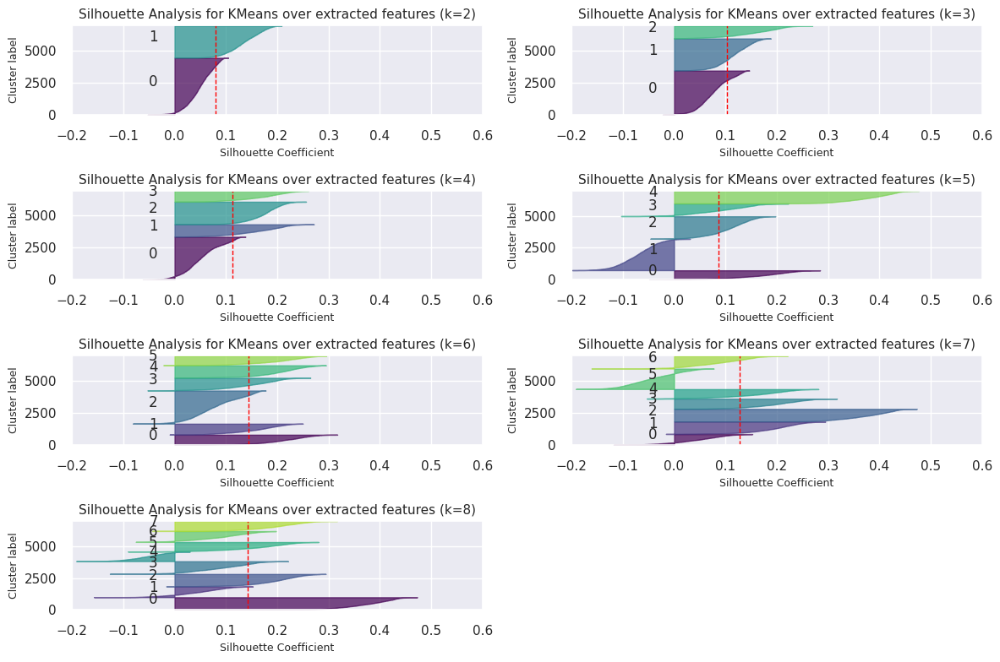

In [ ]:
plot_silhouette(kmeans_models,8)

#### SSE método del codo

https://www.scikit-yb.org/en/latest/api/cluster/elbow.html By default, the parameter locate_elbow is set to True, which automatically find the “elbow” which likely corresponds to the optimal value of k using the “knee point detection algorithm”. La deteccion del codo sería la "más optima" y es automática

In [ ]:
def plot_elbow(model,title):
    # Generate some sample data (replace this with your actual data)
    X = np.array(features.drop(columns=['path','label']))

    visualizer = KElbowVisualizer(model, k=(2, 10), timings=False, title='Elbow Method for KMeans')

    # Fit the data to the visualizer
    visualizer.fit(X)

    # Access the axes object from the visualizer
    axes = visualizer.ax

    # Modify the axis labels
    axes.set_xlabel("k")
    axes.set_ylabel("SSE")
    axes.set_title(f"Elbow Method for {title}")

    # Add a legend
    axes.legend(loc='best')

    # Show the plot
    plt.savefig('elbow_SSE.png')
    #plt.savefig(path_repo+'elbow_SSE.png')
    plt.show()


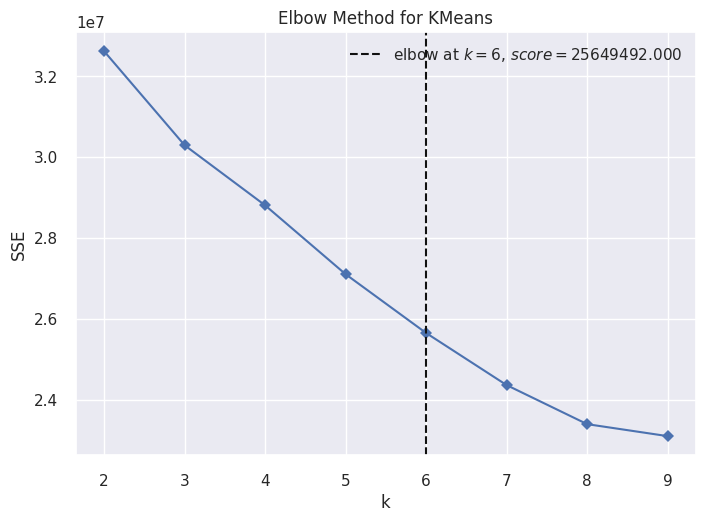

In [ ]:
model = KMeans(n_init=10, random_state=42)
plot_elbow(model,title='KMeans')

### b. Evaluar si el agrupamiento para el k óptimo se condice que las etiquetas de las imágenes utilizando la matriz de confusión y los índices de Rand y van Dongen en los casos que correspondan.

#### matriz de confusión

#### van Dongen e Indice de Rand Ajustado (ARI)

In [ ]:
def vanDongen(ct):
    n2=2*(sum(ct.apply(sum,axis=1)))
    sumi = sum(ct.apply(np.max,axis=1))
    sumj = sum(ct.apply(np.max,axis=0))
    maxsumi = np.max(ct.apply(sum,axis=1))
    maxsumj = np.max(ct.apply(sum,axis=0))
    vd = (n2 - sumi - sumj)/(n2 - maxsumi - maxsumj)
    return vd
from sklearn.metrics import adjusted_rand_score

In [ ]:
def reporte(models,k):
  metricas = pd.DataFrame()

  for k in range(2,k+1):
    matriz = matriz_confusion[f'matriz_confusion_{k}']
    vd = vanDongen(matriz)
    ars = adjusted_rand_score(features.label, models[f'k_{k}'].labels_)
    silhouette = silhouette_score(features.drop(columns=['path','label']), kmeans_models[f'k_{k}'].labels_)
    metricas.loc[k,['Adj_Rand_idx','van_dongen','silhouette']] = vd, ars,silhouette

  return metricas

In [ ]:
reporte_kmeans = reporte(kmeans_models,8)
reporte_kmeans

,Adj_Rand_idx,van_dongen,silhouette
2,0.590530,0.218715,0.080265
3,0.426697,0.355301,0.102268
4,0.343803,0.430331,0.113267
5,0.230680,0.617569,0.085851
6,0.165133,0.663190,0.143749
7,0.067387,0.882745,0.127859
8,0.011348,0.979862,0.142740


In [ ]:
display(matriz_confusion['matriz_confusion_6'])
display(matriz_confusion['matriz_confusion_7'])
display(matriz_confusion['matriz_confusion_8'])

label,airplane,car,cat,dog,flower,fruit,motorbike,person
clusters,,,,,,,,
0,0,0,0,0,0,0,786,0
1,0,0,844,5,1,0,0,0
2,6,1,41,695,840,12,1,986
3,0,0,0,0,0,985,0,0
4,0,966,0,0,0,0,1,0
5,721,1,0,2,2,3,0,0


label,airplane,car,cat,dog,flower,fruit,motorbike,person
clusters,,,,,,,,
0,0,0,0,0,833,2,0,0
1,0,967,0,0,0,0,1,0
2,0,0,0,0,0,0,0,985
3,0,0,0,0,0,0,786,0
4,726,1,1,3,5,4,0,0
5,1,0,884,699,5,3,1,1
6,0,0,0,0,0,991,0,0


label,airplane,car,cat,dog,flower,fruit,motorbike,person
clusters,,,,,,,,
0,0,0,0,0,0,0,0,985
1,0,0,0,0,834,2,0,0
2,0,967,0,0,0,0,1,0
3,0,0,0,0,0,990,0,0
4,0,0,39,697,3,2,0,1
5,727,1,1,4,5,5,0,0
6,0,0,845,1,1,1,0,0
7,0,0,0,0,0,0,787,0


### c. Visualizar los clusters y las etiquetas de género en baja dimensión con alguna técnica de reducción (PCA, TSNE, MDS, etc).

#### Silhoutte + PCA

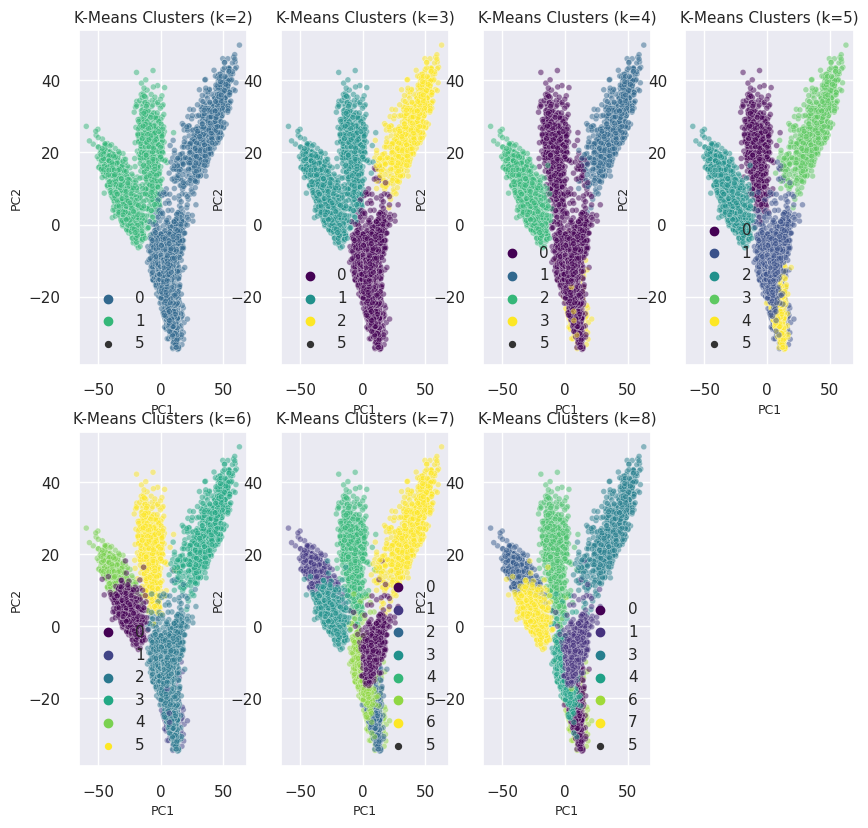

In [ ]:
import seaborn as sns

#plot clusters with pca in every model
pca = PCA(random_state=42,n_components=3)
pca_mtx = pca.fit_transform(np.array(features.drop(columns=['path','label'])))

num_rows = len(range_n_clusters) // 2 + len(range_n_clusters) % 2  # Calculate the number of rows for subplots
plt.figure(figsize=(10, 5 * num_rows))

for i, n_clusters in enumerate(range_n_clusters):
    plt.subplot(num_rows, 4, i + 1)  # Create subplots in a 2-column grid

    cluster_labels = kmeans_models[f'k_{n_clusters}'].labels_

    sns.scatterplot(data=pd.DataFrame(pca_mtx), x=pca_mtx[:,0], y=pca_mtx[:,1],
                    hue=cluster_labels, palette='viridis', alpha=0.5,size=5)
    plt.title(f"K-Means Clusters (k={n_clusters})", fontsize=11)
    plt.xlabel("PC1",fontsize=9)
    plt.ylabel("PC2",fontsize=9)



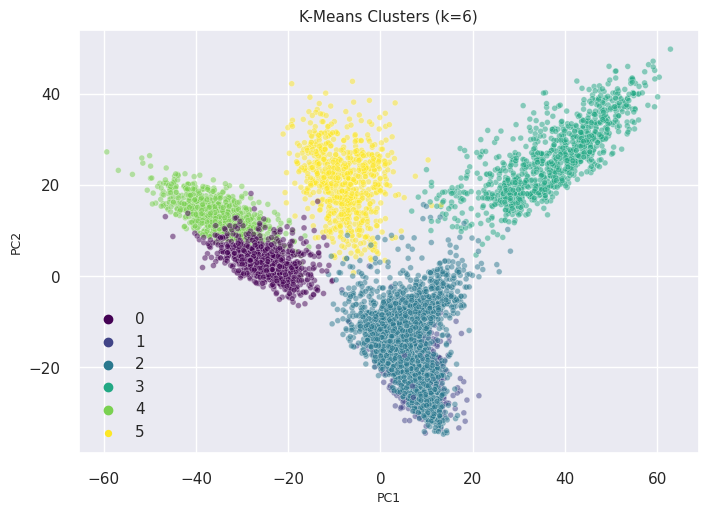

In [ ]:
#plot clusters with pca in every model
pca = PCA(random_state=42,n_components=3)
pca_mtx = pca.fit_transform(np.array(features.drop(columns=['path','label'])))

#num_rows = len(range_n_clusters) // 2 + len(range_n_clusters) % 2  # Calculate the number of rows for subplots
#plt.figure(figsize=(10, 5 * num_rows))

cluster_labels = kmeans_models['k_6'].labels_
sns.scatterplot(data=pd.DataFrame(pca_mtx), x=pca_mtx[:,0], y=pca_mtx[:,1],
                    hue=cluster_labels, palette='viridis', alpha=0.5,size=5)
plt.title(f"K-Means Clusters (k=6)", fontsize=11)
plt.xlabel("PC1",fontsize=9)
plt.ylabel("PC2",fontsize=9)
plt.savefig('kmeans pca k = 6.png')

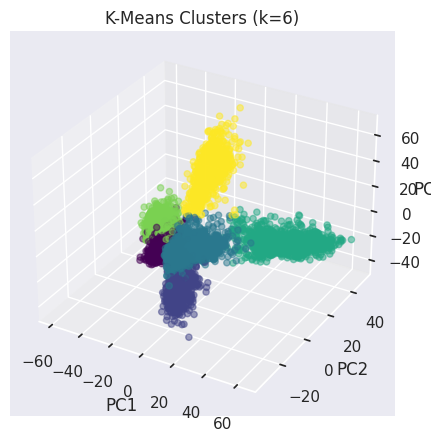

In [ ]:
# scatter plot with 3 dimensions
fig = plt.figure(figsize=(5, 5))
ax = fig.add_subplot(111, projection='3d')
ax.scatter(pca_mtx[:,0], pca_mtx[:,1], pca_mtx[:,2], c=kmeans_models['k_6'].labels_, cmap='viridis', alpha=0.5)
ax.set_ylabel('PC2')
ax.set_xlabel('PC1')
ax.set_zlabel('PC3')
plt.legend()

plt.title('K-Means Clusters (k=6)')
plt.savefig('kmeans pca 3d k = 6.png')

ValueError: ignored

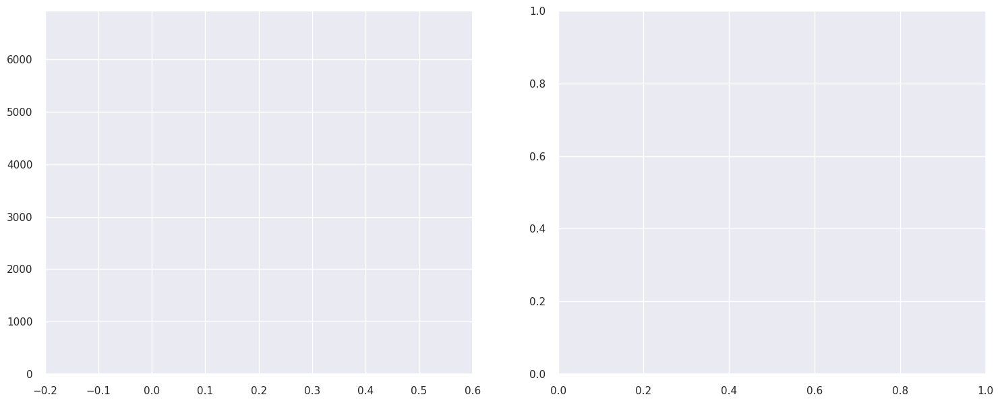

In [ ]:
import matplotlib.cm as cm
import matplotlib.pyplot as plt
import numpy as np

from sklearn.cluster import KMeans
from sklearn.datasets import make_blobs
from sklearn.metrics import silhouette_samples, silhouette_score

# Generating the sample data from make_blobs
# This particular setting has one distinct cluster and 3 clusters placed close
# together.
X = np.array(features.iloc[:,:-1])

range_n_clusters = [2, 3, 4, 5, 6, 7, 8]

for n_clusters in range_n_clusters:
    # Create a subplot with 1 row and 2 columns
    fig, (ax1, ax2) = plt.subplots(1, 2)
    fig.set_size_inches(18, 7)

    # The 1st subplot is the silhouette plot
    # The silhouette coefficient can range from -1, 1 but in this example all
    # lie within [-0.1, 1]
    ax1.set_xlim([-0.2, 0.6]) #Cambie aca
    # The (n_clusters+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    ax1.set_ylim([0, len(X) + (n_clusters + 1) * 10])

    # Initialize the clusterer with n_clusters value and a random generator
    # seed of 10 for reproducibility.
    clusterer = KMeans(n_clusters=n_clusters, n_init=10, random_state=42)
    cluster_labels = clusterer.fit_predict(X)

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed
    # clusters
    silhouette_avg = silhouette_score(X, cluster_labels)
    print(
        "For n_clusters =",
        n_clusters,
        "The average silhouette_score is :",
        silhouette_avg,
    )

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(X, cluster_labels)

    y_lower = 10

    pca = PCA(n_components=.8, random_state=42)
    pca.fit(np.array(features.iloc[:,:-1]))
    x = pca.transform(np.array(features.iloc[:,:-1]))

    for i in range(n_clusters):
        # Aggregate the silhouette scores for samples belonging to
        # cluster i, and sort them
        ith_cluster_silhouette_values = sample_silhouette_values[cluster_labels == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = plt.cm.tab10(float(i) / n_clusters)
        ax1.fill_betweenx(
            np.arange(y_lower, y_upper),
            0,
            ith_cluster_silhouette_values,
            facecolor=color,
            edgecolor=color,
            alpha=0.7,
        )

        # Label the silhouette plots with their cluster numbers at the middle
        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    ax1.set_title("The silhouette plot for the various clusters.")
    ax1.set_xlabel("The silhouette coefficient values")
    ax1.set_ylabel("Cluster label")

    # The vertical line for average silhouette score of all the values
    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

    ax1.set_yticks([])  # Clear the yaxis labels / ticks
    #ax1.set_xticks([-0.2,-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1.0])
    ax1.set_xticks(np.arange(-0.2, 0.6 + 0.1, 0.1))  #cambie un poco la escala del gráfico

    # 2nd Plot showing the actual clusters formed
    colors = plt.cm.tab10(cluster_labels.astype(float) / n_clusters)
    ax2.scatter(
        x[:, 0], x[:, 1], marker=".", s=30, lw=0,  c=colors, edgecolor="k", alpha = 0.5
    )

    # # Labeling the clusters - > El centro de los clusters son muy cercanos y no queda bien en el gráfico (en los ejemplos de make_blobs se ve hermoso)
    # centers = clusterer.cluster_centers_
    # # Draw white circles at cluster centers
    # ax2.scatter(
    #     centers[:, 0],
    #     centers[:, 1],
    #     marker="o",
    #     c="white",
    #     alpha=1,
    #     s=200,
    #     edgecolor="k",
    # )

    # for i, c in enumerate(centers):
    #     ax2.scatter(c[0], c[1], marker="$%d$" % i, alpha=1, s=50, edgecolor="k")

    ax2.set_title("The visualization of the clustered data with PCA.")
    ax2.set_xlabel("PC1")
    ax2.set_ylabel("PC2")

    plt.suptitle(
        "Silhouette analysis for KMeans clustering on extracted features with n_clusters = %d"
        % n_clusters,
        fontsize=14,
        fontweight="bold",
    )

plt.show()

In [ ]:
#tsne para romper las pelotas

pca_tsne = PCA(random_state=42,n_components=200)
pca_mtx1_tsne = pca_tsne.fit_transform(np.array(features.drop(columns=['path','label'])))

#varianza total explicada
print('Varianza total explicada: ', np.sum(pca_tsne.explained_variance_ratio_))

from sklearn.manifold import TSNE
tsne = TSNE(n_components=2, verbose=0, perplexity=40, n_iter=300)
tsne_pca_results = tsne.fit_transform(pca_mtx1_tsne)

features['tsne-pca200-one'] = tsne_pca_results[:,0]
features['tsne-pca200-two'] = tsne_pca_results[:,1]
#features['tsne-pca200-three'] = tsne_pca_results[:,2]


Varianza total explicada:  0.79498345


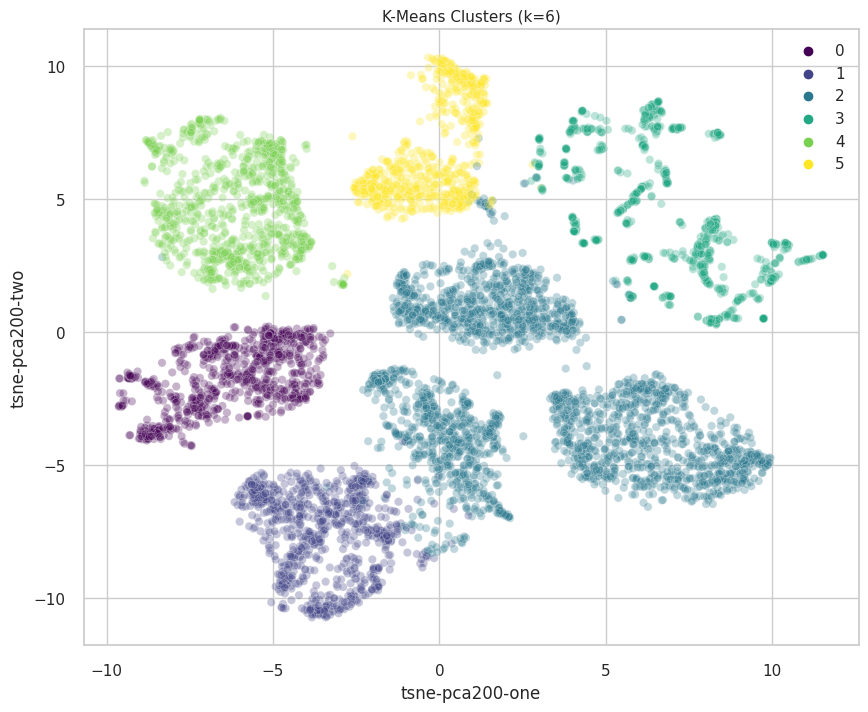

In [ ]:
import seaborn as sns
plt.figure(figsize=(10,8))
sns.set(style='whitegrid')
sns.scatterplot(
    x="tsne-pca200-one", y="tsne-pca200-two",
    hue=kmeans_models['k_6'].labels_,
    palette="viridis",
    data=features,
    legend="full",
    alpha=0.3
)
plt.title(f"K-Means Clusters (k=6)", fontsize=11)
plt.savefig('tsne kmeans k = 6.png')

#### Ver imagenes por cluster ("modifique" el codigo para que vayan cambiando las imagenes random en cada grupo)

In [ ]:
import random

# function that lets you view a cluster (based on identifier)
def view_cluster(gps, cluster):
    plt.figure(figsize=(25, 25))
    # gets the list of filenames for a cluster
    files = gps
    # shuffle the list of files randomly
    random.shuffle(files)
    # only allow up to 10 random images to be shown at a time
    num_images_to_show = min(10, len(files))
    files_to_show = files[:num_images_to_show]
    # plot each image in the cluster
    for index, file in enumerate(files_to_show):
        plt.subplot(1, 10, index + 1)
        img = Image.open(file)
        img = np.array(img)
        plt.imshow(img)
        plt.title('Cluster n:' + str(cluster))
        plt.axis('off')

#En esta parte elegir el numero de clusters
clustering_labels = kmeans_models['k_6'].labels_

# holds the cluster id and the images { id: [images] }
groups = {}
for file, cluster in zip(np.array(features['path']), clustering_labels):
    if cluster not in groups.keys():
        groups[cluster] = []
        groups[cluster].append(file)
    else:
        groups[cluster].append(file)

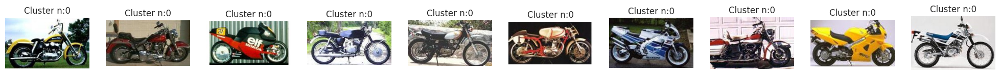

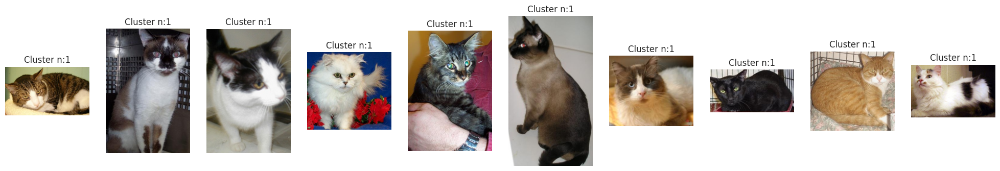

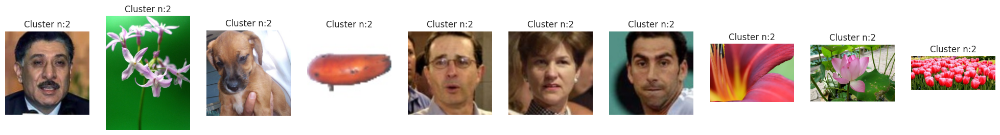

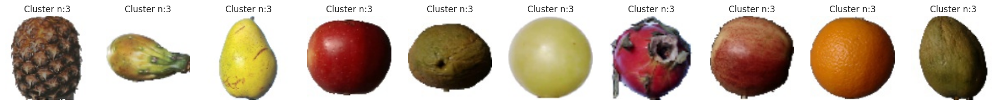

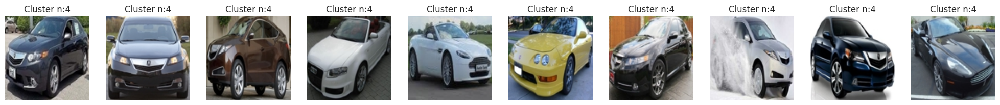

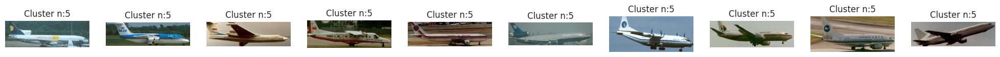

In [ ]:
for n in range(len(groups)):
    view_cluster(groups[n], n)

### d. Discuta brevemente los resultados obtenidos

Repetir los pasos para al menos otros dos algoritmos de clustering. En el paso a) considerar los hiper-parámetros y la métrica de validación interna que corresponda. Comparar y discutir brevemente los resultados obtenidos

## PAM

In [ ]:
pip install scikit-learn-extra

In [ ]:
from sklearn_extra.cluster import KMedoids

In [ ]:
#Para guardar todas las matrices en un diccionario para luego verlas individualmente
n_clusters = [2,3,4,5,6,7,8]

kmedoids_models = {}
kmedoids_mx_conf = {}

for k in n_clusters:
  model = KMedoids(n_clusters=k,init='k-medoids++', random_state=42)
  labels = model.fit_predict(features.drop(columns=['path','label']))
  kmedoids_models[f'k_{k}'] = model
  confusion_matrix = pd.crosstab(labels, features['label'], rownames=['clusters'])
  kmedoids_mx_conf[f'matriz_confusion_{k}'] = confusion_matrix

In [ ]:
from sklearn.metrics import silhouette_score, silhouette_samples

# Generate some sample data
X = np.array(features.drop(columns=['path','label']))

range_n_clusters = [2, 3, 4, 5, 6, 7, 8]

sns.set(style='whitegrid')

for n_clusters in range_n_clusters:
    plt.figure(figsize=(15, 7))
    plt.subplots_adjust(left=0.02, right=0.98, top=0.94, bottom=0.1)

    plt.subplot(1, 2, 1)
    plt.xlim([-0.2, 1])
    plt.ylim([0, len(X) + (n_clusters + 1) * 10])

    cluster_labels = kmedoids_models[f'k_{n_clusters}'].labels_

    silhouette_avg = silhouette_score(X, cluster_labels)
    print("For n_clusters =", n_clusters,
          "The average silhouette_score is :", silhouette_avg)

    sample_silhouette_values = silhouette_samples(X, cluster_labels)
    y_lower = 10

    for i in range(n_clusters):
        ith_cluster_silhouette_values = sample_silhouette_values[cluster_labels == i]
        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        colors = plt.cm.viridis(float(i) / n_clusters)
        plt.fill_betweenx(np.arange(y_lower, y_upper),
                          0, ith_cluster_silhouette_values,
                          facecolor=colors, edgecolor=colors, alpha=0.7)

        plt.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))
        y_lower = y_upper + 10

    plt.axvline(x=silhouette_avg, color="red", linestyle="--", linewidth=1)

    #plt.title("Silhouette analysis for KMeans clustering on sample data with n_clusters = %d" % n_clusters)
    plt.title(f"K-Medoids Análisis de Coeficiente Silhouette sobre features extraídas (n_clusters= {n_clusters})")
    plt.xlabel("Coeficiente de Silhouette")
    plt.ylabel("Cluster label")
    plt.savefig(f'silhouette k = {n_clusters}.png')

    plt.show()

For k = 2 The average silhouette_score is : 0.06132555
For k = 3 The average silhouette_score is : 0.06235598
For k = 4 The average silhouette_score is : 0.044880822
For k = 5 The average silhouette_score is : 0.08543149
For k = 6 The average silhouette_score is : 0.10015065
For k = 7 The average silhouette_score is : 0.13298352
For k = 8 The average silhouette_score is : 0.06632328


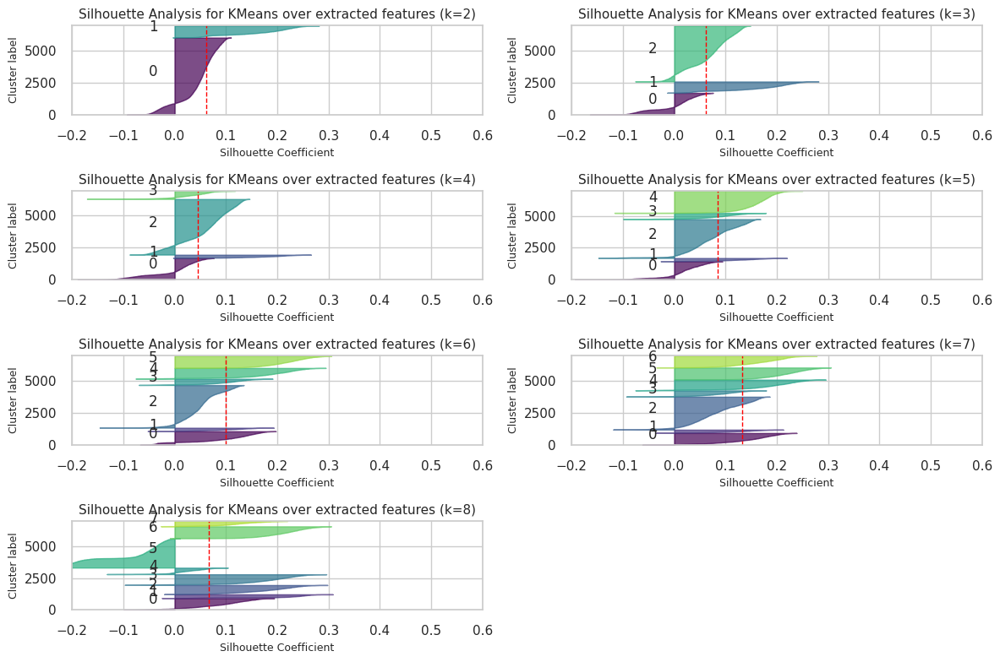

In [ ]:
plot_silhouette(kmedoids_models,8)

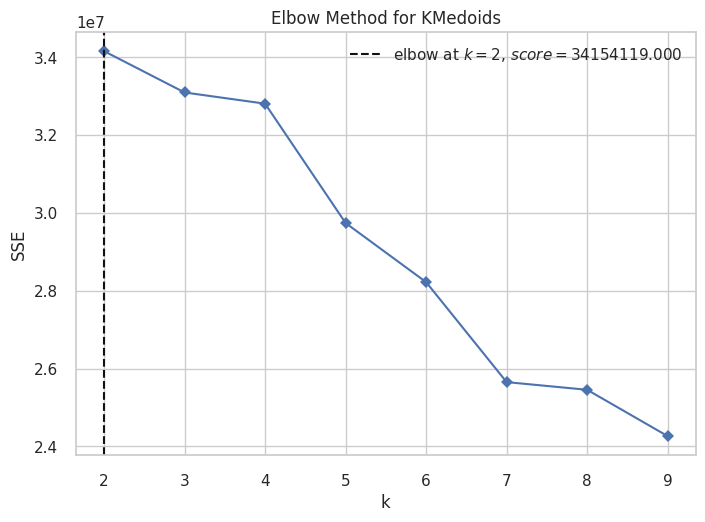

In [ ]:
model = KMedoids(init='k-medoids++', random_state=42)
sns.set(style='whitegrid')
plot_elbow(model,title='KMedoids')

In [ ]:
def reporte_kmed(models,k):
  metricas = pd.DataFrame()

  for k in range(2,k+1):
    matriz = matriz_confusion[f'matriz_confusion_{k}']
    vd = vanDongen(matriz)
    ars = adjusted_rand_score(features.label, kmedoids_models[f'k_{k}'].labels_)
    silhouette = silhouette_score(features.drop(columns=['path','label']), kmedoids_models[f'k_{k}'].labels_)
    metricas.loc[k,['Adj_Rand_idx','van_dongen','silhouette']] = vd, ars,silhouette

  return metricas

In [ ]:
report_kmedoids = reporte_kmed(kmedoids_models,8)
report_kmedoids

,Adj_Rand_idx,van_dongen,silhouette
2,0.590530,0.063912,0.061326
3,0.426697,0.167577,0.062356
4,0.343803,0.152810,0.044881
5,0.230680,0.377684,0.085431
6,0.165133,0.416847,0.100151
7,0.067387,0.609839,0.132984
8,0.011348,0.597542,0.066323


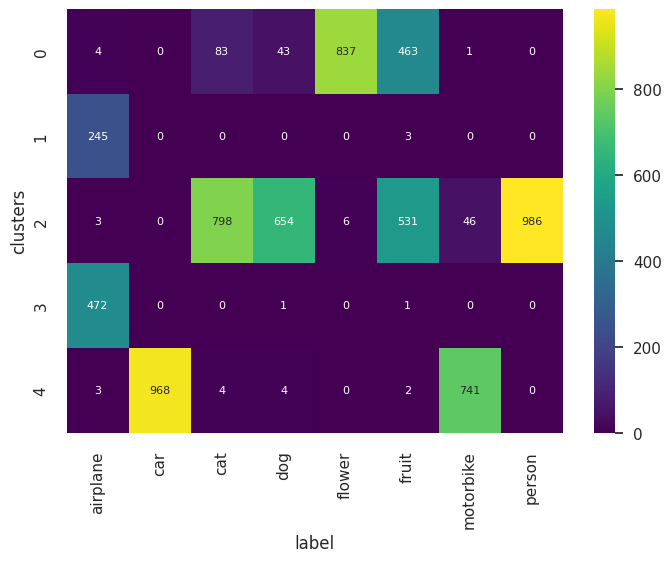

In [ ]:
df_conf = kmedoids_mx_conf['matriz_confusion_5']

# plt.figure(figsize=(10,7))
sn.set(font_scale=1) # for label size
sn.heatmap(df_conf, annot=True, annot_kws={"size": 8}, cmap = 'viridis',fmt='g') # font size
plt.savefig('matriz_conf_5_kmed.png')
plt.show()

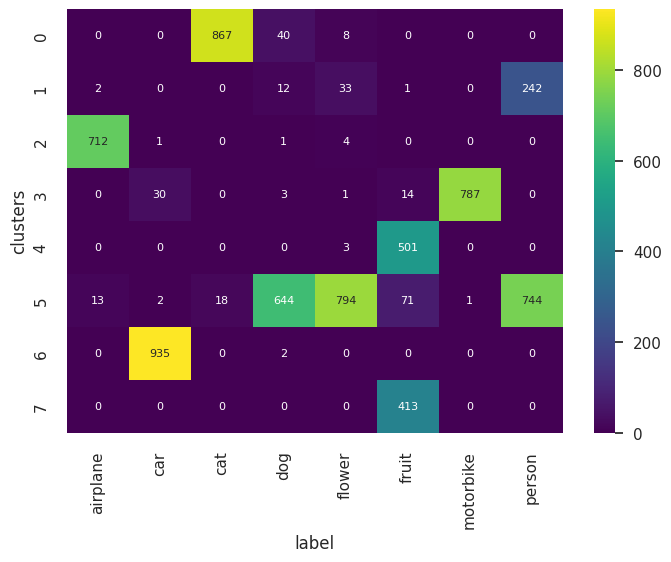

In [ ]:
df_conf = kmedoids_mx_conf['matriz_confusion_8']

# plt.figure(figsize=(10,7))
sn.set(font_scale=1) # for label size
sn.heatmap(df_conf, annot=True, annot_kws={"size": 8}, cmap = 'viridis',fmt='g') # font size
plt.savefig('matriz_conf_8_kmed.png')
plt.show()

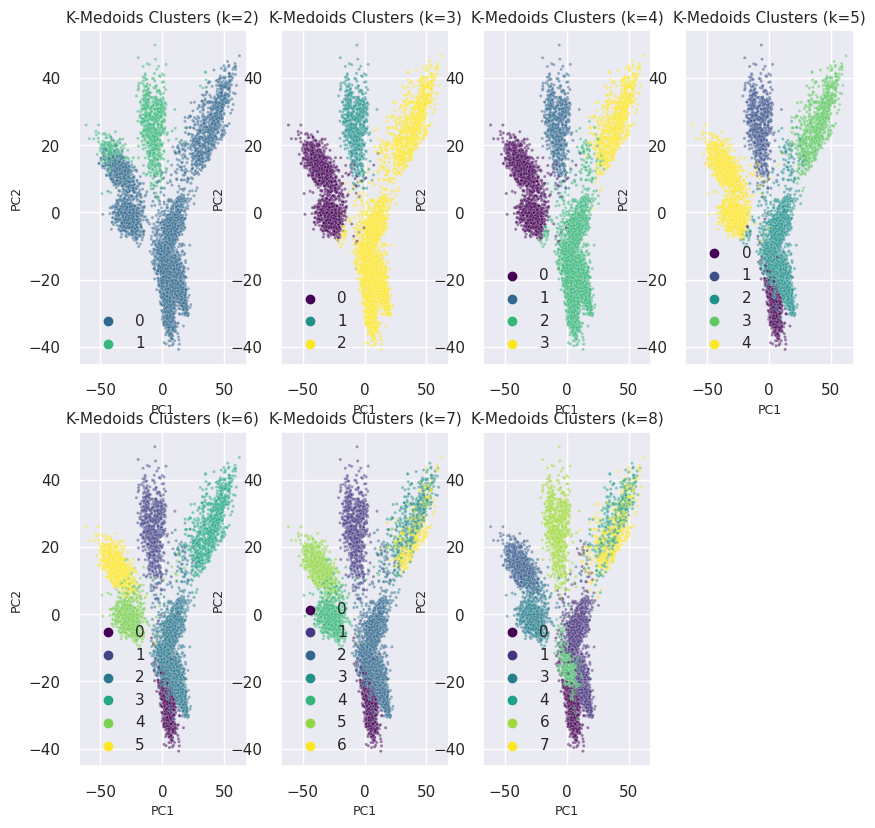

In [ ]:
#plot clusters with pca in every model
pca = PCA(random_state=42,n_components=3)
pca_mtx = pca.fit_transform(np.array(features.drop(columns=['path','label'])))

num_rows = len(range_n_clusters) // 2 + len(range_n_clusters) % 2  # Calculate the number of rows for subplots
plt.figure(figsize=(10, 5 * num_rows))

for i, n_clusters in enumerate(range_n_clusters):
    plt.subplot(num_rows, 4, i + 1)  # Create subplots in a 2-column grid

    cluster_labels = kmedoids_models[f'k_{n_clusters}'].labels_

    sns.scatterplot(data=pd.DataFrame(pca_mtx), x=pca_mtx[:,0], y=pca_mtx[:,1],
                    hue=cluster_labels, palette='viridis', alpha=0.5,s=5)
    plt.title(f"K-Medoids Clusters (k={n_clusters})", fontsize=11)
    plt.xlabel("PC1",fontsize=9)
    plt.ylabel("PC2",fontsize=9)

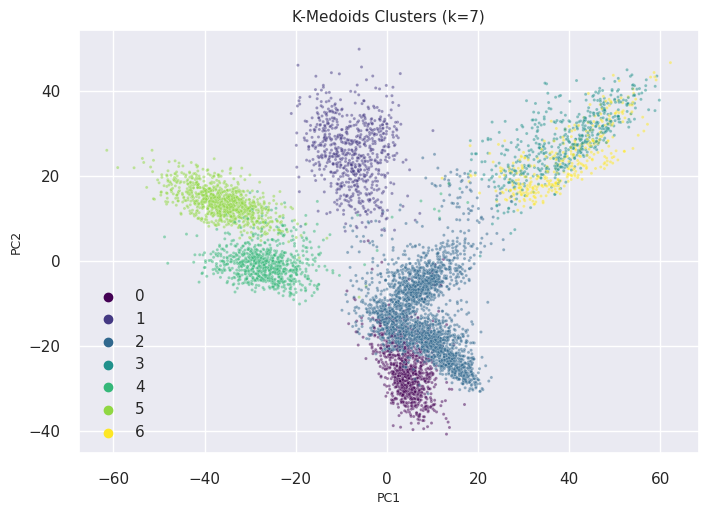

In [ ]:
#plot clusters with pca in every model
pca = PCA(random_state=42,n_components=3)
pca_mtx = pca.fit_transform(np.array(features.drop(columns=['path','label'])))

#num_rows = len(range_n_clusters) // 2 + len(range_n_clusters) % 2  # Calculate the number of rows for subplots
#plt.figure(figsize=(10, 5 * num_rows))

cluster_labels = kmedoids_models['k_7'].labels_
sns.scatterplot(data=pd.DataFrame(pca_mtx), x=pca_mtx[:,0], y=pca_mtx[:,1],
                    hue=cluster_labels, palette='viridis', alpha=0.5,s=5)
plt.title(f"K-Medoids Clusters (k=7)", fontsize=11)
plt.xlabel("PC1",fontsize=9)
plt.ylabel("PC2",fontsize=9)
plt.savefig('kmeds pca k = 7.png')

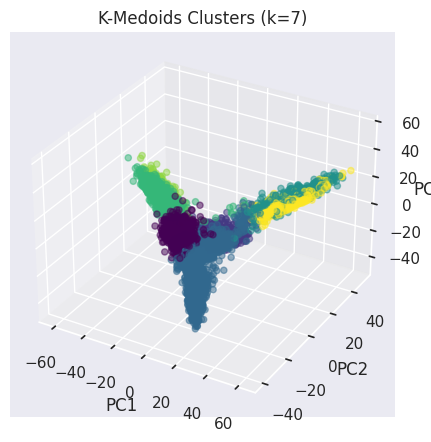

In [ ]:
# scatter plot with 3 dimensions
fig = plt.figure(figsize=(5, 5))
ax = fig.add_subplot(111, projection='3d')
ax.scatter(pca_mtx[:,0], pca_mtx[:,1], pca_mtx[:,2], c=kmedoids_models['k_7'].labels_, cmap='viridis', alpha=0.5)
ax.set_ylabel('PC2')
ax.set_xlabel('PC1')
ax.set_zlabel('PC3')
plt.title('K-Medoids Clusters (k=7)')
plt.savefig('kmeds pca 3d k = 7.png')

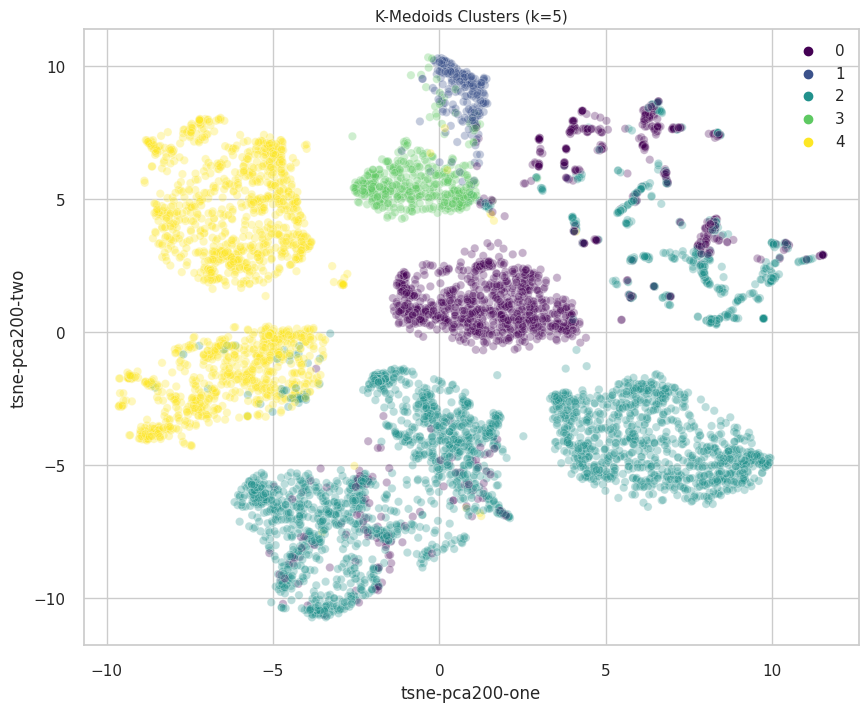

In [ ]:
#tsne para romper las pelotas
plt.figure(figsize=(10,8))
sns.set(style = 'whitegrid')
sns.scatterplot(
    x="tsne-pca200-one", y="tsne-pca200-two",
    hue=kmedoids_models['k_5'].labels_,
    palette="viridis",
    data=features,
    legend="full",
    alpha=0.3
)
plt.title(f"K-Medoids Clusters (k=5)", fontsize=11)
plt.savefig('tsne kmeds k = 5.png')

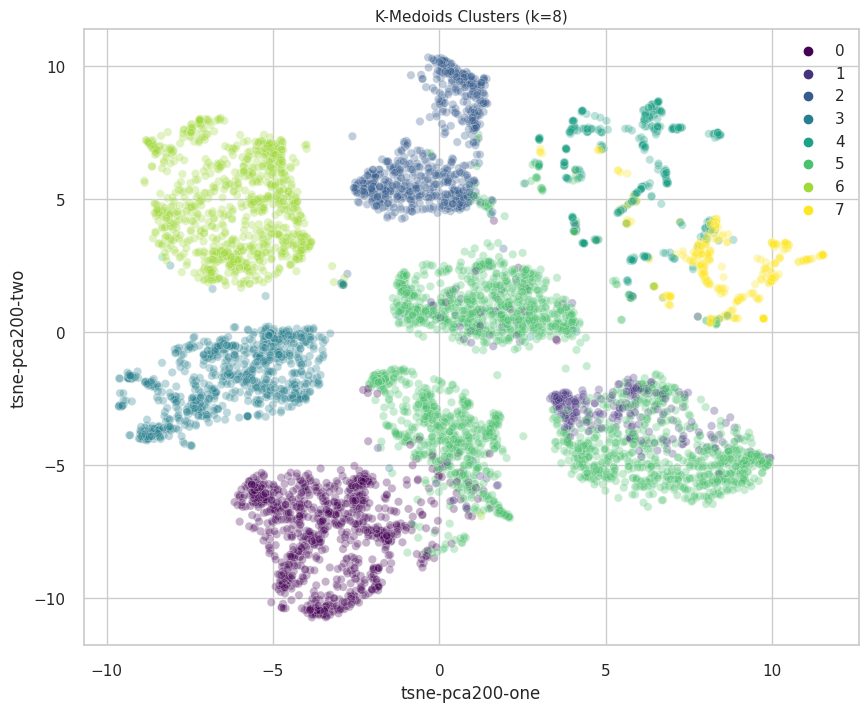

In [ ]:
#tsne para romper las pelotas
plt.figure(figsize=(10,8))
sns.set(style = 'whitegrid')
sns.scatterplot(
    x="tsne-pca200-one", y="tsne-pca200-two",
    hue=kmedoids_models['k_8'].labels_,
    palette="viridis",
    data=features,
    legend="full",
    alpha=0.3
)
plt.title(f"K-Medoids Clusters (k=8)", fontsize=11)
plt.savefig('tsne kmeds k = 8.png')

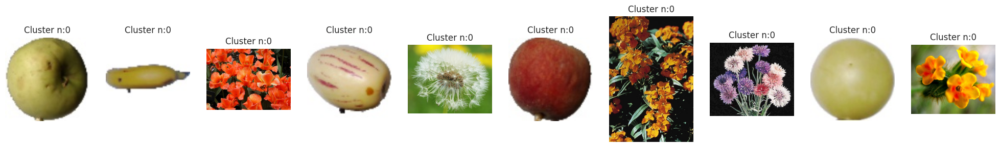

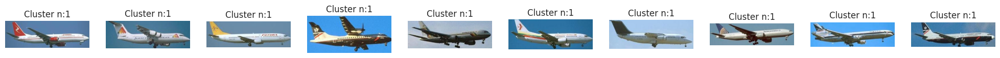

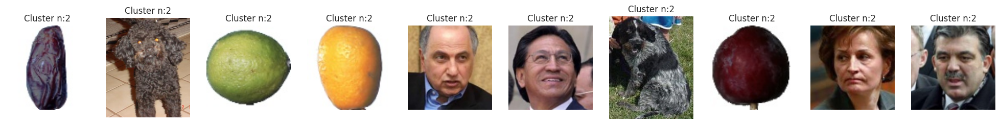

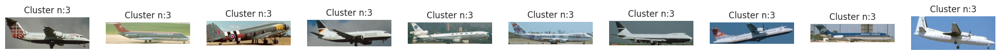

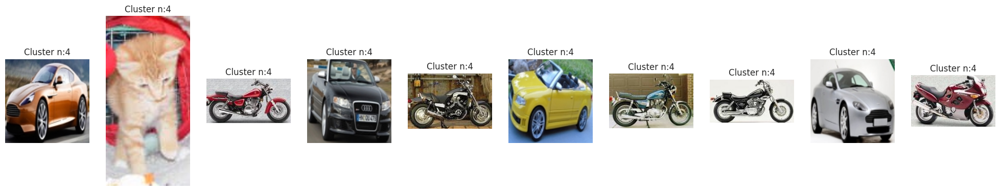

In [ ]:
#En esta parte elegir el numero de clusters
clustering_labels = kmedoids_models['k_5'].labels_

# holds the cluster id and the images { id: [images] }
groups = {}
for file, cluster in zip(np.array(features['path']), clustering_labels):
    if cluster not in groups.keys():
        groups[cluster] = []
        groups[cluster].append(file)
    else:
        groups[cluster].append(file)

for n in range(len(groups)):
    view_cluster(groups[n], n)

In [ ]:
kmedoids_mx_conf['matriz_confusion_5']

label,airplane,car,cat,dog,flower,fruit,motorbike,person
clusters,,,,,,,,
0,4,0,83,43,837,463,1,0
1,245,0,0,0,0,3,0,0
2,3,0,798,654,6,531,46,986
3,472,0,0,1,0,1,0,0
4,3,968,4,4,0,2,741,0


## DBSCAN

###DBSCAN datos crudos
Ya esta calculado y guardado en el drive un dataframe, como para no correrlo nuevamente en caso que no encuentren ningun error (toma un tiempito, unos 15min). Esta al final calculos para poder leerlo directamente

####Calculos

In [ ]:
from sklearn.cluster import DBSCAN
import numpy as np

# Take the entire dataset without dimension reduction or standardization
X = np.array(features.drop(columns=['path','label']))

# Define lists of eps and min_samples values
eps_values = [0.1, 0.5, 1.0, 2, 5, 10, 20, 30, 40, 50]
min_samples_values = [2, 5, 10, 15, 20, 25, 50]

clustering_results = {}  # Store the results for different combinations

for eps in eps_values:
    for min_samples in min_samples_values:
        # Perform DBSCAN clustering for the current combination of eps and min_samples
        clustering_DBSCAN = DBSCAN(eps=eps, min_samples=min_samples).fit(X)

        # Store the cluster labels in the results dictionary
        key = f'eps={eps}_min_samples={min_samples}'
        clustering_results[key] = {
            'labels': clustering_DBSCAN.labels_,
            'n_clusters': len(set(clustering_DBSCAN.labels_)) - (1 if -1 in clustering_DBSCAN.labels_ else 0),
            'n_noise': list(clustering_DBSCAN.labels_).count(-1)
        }

        # Print the results for the current combination
        print(f'eps={eps}, min_samples={min_samples}')
        print("Cluster labels:")
        print(clustering_DBSCAN.labels_)
        print("Estimated number of clusters: %d" % clustering_results[key]['n_clusters'])
        print("Estimated number of noise points: %d" % clustering_results[key]['n_noise'])
        print()

eps=0.1, min_samples=2
Cluster labels:
[-1 -1 -1 ... -1 -1 -1]
Estimated number of clusters: 2
Estimated number of noise points: 6895

eps=0.1, min_samples=5
Cluster labels:
[-1 -1 -1 ... -1 -1 -1]
Estimated number of clusters: 0
Estimated number of noise points: 6899

eps=0.1, min_samples=10
Cluster labels:
[-1 -1 -1 ... -1 -1 -1]
Estimated number of clusters: 0
Estimated number of noise points: 6899

eps=0.1, min_samples=15
Cluster labels:
[-1 -1 -1 ... -1 -1 -1]
Estimated number of clusters: 0
Estimated number of noise points: 6899

eps=0.1, min_samples=20
Cluster labels:
[-1 -1 -1 ... -1 -1 -1]
Estimated number of clusters: 0
Estimated number of noise points: 6899

eps=0.1, min_samples=25
Cluster labels:
[-1 -1 -1 ... -1 -1 -1]
Estimated number of clusters: 0
Estimated number of noise points: 6899

eps=0.1, min_samples=50
Cluster labels:
[-1 -1 -1 ... -1 -1 -1]
Estimated number of clusters: 0
Estimated number of noise points: 6899

eps=0.5, min_samples=2
Cluster labels:
[-1 -1 -1 .

In [ ]:
df_DBSCAN_results = pd.DataFrame(clustering_results).T.reset_index().rename(columns={'index': 'parametros'})

In [ ]:
df_DBSCAN_results.shape

(70, 4)

In [ ]:
#Esto lo podria haber hecho antes, pero me acorde tarde y lo agregue dps..hay varias medidas que no las vimos y
#por ahi ni se usan pero era rapido el calculo (solo el silhouette demora)

#Medidas de validacion

import sklearn.metrics

# Assuming df_DBSCAN_results.labels is a DataFrame column
labels_column = df_DBSCAN_results['labels']

# Create empty lists to store the scores
homogeneity_scores = []
completeness_scores = []
v_measure_scores = []
adjusted_rand_scores = []
adjusted_mutual_info_scores = []
silhouette_coefficients = []

for labels in labels_column:
    homogeneity = sklearn.metrics.homogeneity_score(features.label, labels)
    completeness = sklearn.metrics.completeness_score(features.label, labels)
    v_measure = sklearn.metrics.v_measure_score(features.label, labels)
    adjusted_rand = sklearn.metrics.adjusted_rand_score(features.label, labels)
    adjusted_mutual_info = sklearn.metrics.adjusted_mutual_info_score(features.label, labels)

    if len(set(labels)) == 1:
      silhouette = float('nan')
    else:
      silhouette = sklearn.metrics.silhouette_score(X, labels)


    homogeneity_scores.append(homogeneity)
    completeness_scores.append(completeness)
    v_measure_scores.append(v_measure)
    adjusted_rand_scores.append(adjusted_rand)
    adjusted_mutual_info_scores.append(adjusted_mutual_info)
    silhouette_coefficients.append(silhouette)

# Add the scores as new columns to your DataFrame
df_DBSCAN_results['homogeneity'] = homogeneity_scores
df_DBSCAN_results['completeness'] = completeness_scores
df_DBSCAN_results['v_measure'] = v_measure_scores
df_DBSCAN_results['adjusted_rand'] = adjusted_rand_scores
df_DBSCAN_results['adjusted_mutual_info'] = adjusted_mutual_info_scores
df_DBSCAN_results['silhouette'] = silhouette_coefficients

In [ ]:
df_DBSCAN_results.to_pickle(path_repo+'clustering_results.pkg')

In [ ]:
df_DBSCAN_results = pd.read_pickle(path_repo+'clustering_results.pkg')

####Resultados

In [ ]:
df_DBSCAN_results[df_DBSCAN_results.n_clusters.isin([3,4,5,6,7,8])].sort_values(by='silhouette', ascending=False)

,parametros,labels,n_clusters,n_noise,homogeneity,completeness,v_measure,adjusted_rand,adjusted_mutual_info,silhouette
69,eps=50_min_samples=50,"[-1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -...",4,5193,0.286023,0.711626,0.408042,0.110079,0.407207,-0.049627
51,eps=30_min_samples=10,"[-1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -...",5,6838,0.008359,0.267501,0.016211,-0.000551,0.013436,-0.057483
60,eps=40_min_samples=20,"[-1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -...",5,6168,0.115494,0.594997,0.193439,0.029793,0.191652,-0.064778
59,eps=40_min_samples=15,"[-1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -...",6,6119,0.123448,0.587775,0.204042,0.032172,0.201946,-0.066569
68,eps=50_min_samples=25,"[-1, -1, -1, -1, -1, -1, -1, -1, -1, -1, 0, -1...",8,4662,0.358576,0.638799,0.459322,0.129930,0.457943,-0.071279
35,eps=10_min_samples=2,"[-1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -...",5,6889,0.001382,0.216022,0.002747,-0.000079,0.000709,-0.182607


##### matriz de confusión

In [ ]:
#Para guardar todas las matrices en un diccionario para luego verlas individualmente
mejores_resultados_DBSCAN = df_DBSCAN_results[df_DBSCAN_results.n_clusters.isin([3,4,5,6,7,8])].sort_values(by='silhouette', ascending=False)

matriz_confusion_DBSCAN_results = {}

for index, row in mejores_resultados_DBSCAN.iterrows():
  k = mejores_resultados_DBSCAN.parametros[index]
  confusion_matrix = pd.crosstab(row['labels'], features['label'], rownames=['clusters'])
  matriz_confusion_DBSCAN_results[f'matriz_confusion_DBSCAN_results_{k}'] = confusion_matrix

In [ ]:
#elegir que matriz ver
matriz_confusion_DBSCAN_results_k = mejores_resultados_DBSCAN.parametros.loc[69]
matriz_confusion_DBSCAN_results[f'matriz_confusion_DBSCAN_results_{matriz_confusion_DBSCAN_results_k}']

label,airplane,car,cat,dog,flower,fruit,motorbike,person
clusters,,,,,,,,
-1,727,503,885,702,843,912,564,57
0,0,465,0,0,0,0,0,0
1,0,0,0,0,0,0,0,929
2,0,0,0,0,0,88,0,0
3,0,0,0,0,0,0,224,0


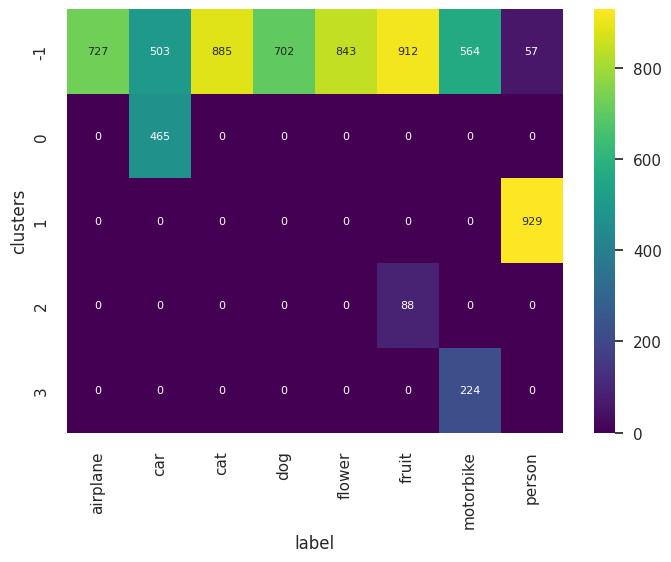

In [ ]:
df_conf = matriz_confusion_DBSCAN_results[f'matriz_confusion_DBSCAN_results_{matriz_confusion_DBSCAN_results_k}']

# plt.figure(figsize=(10,7))
sn.set(font_scale=1) # for label size
sn.heatmap(df_conf, annot=True, annot_kws={"size": 8}, cmap = 'viridis',fmt='g') # font size
plt.savefig('matriz_conf_DBSCAN.png')
plt.show()

##### van Dongen

In [ ]:
def vanDongen(ct):
    n2=2*(sum(ct.apply(sum,axis=1)))
    sumi = sum(ct.apply(np.max,axis=1))
    sumj = sum(ct.apply(np.max,axis=0))
    maxsumi = np.max(ct.apply(sum,axis=1))
    maxsumj = np.max(ct.apply(sum,axis=0))
    vd = (n2 - sumi - sumj)/(n2 - maxsumi - maxsumj)
    return vd

In [ ]:
for i in range(len(matriz_confusion_DBSCAN_results)):
  matriz = matriz_confusion_DBSCAN_results[f'matriz_confusion_DBSCAN_results_{mejores_resultados_DBSCAN.parametros.iloc[i]}']
  vd = vanDongen(matriz)
  print(f'van Dongen k={mejores_resultados_DBSCAN.parametros.iloc[i]} --> {vd}')

van Dongen k=eps=50_min_samples=50 --> 0.6725838264299803
van Dongen k=eps=30_min_samples=10 --> 0.9921140939597315
van Dongen k=eps=40_min_samples=20 --> 0.8541478129713423
van Dongen k=eps=40_min_samples=15 --> 0.8418924988770774
van Dongen k=eps=50_min_samples=25 --> 0.6311455260570304
van Dongen k=eps=10_min_samples=2 --> 0.9989845997630733


##### Grafico

In [ ]:
import seaborn as sns

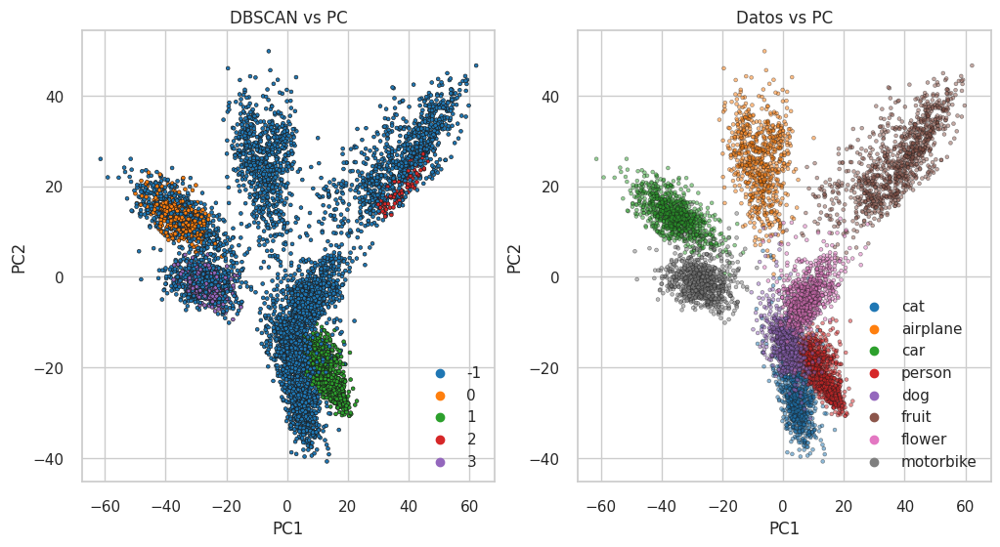

In [ ]:
fig, ax = plt.subplots(1,2, figsize=(12,6))
sns.scatterplot(x=pca_mtx[:,0], y=pca_mtx[:,1], marker=".", s=30, lw=0, edgecolor="k", alpha = 1, hue=mejores_resultados_DBSCAN['labels'].iloc[0], palette='tab10', ax=ax[0])
ax[0].set_xlabel('PC1')
ax[0].set_ylabel('PC2')
ax[0].set_title('DBSCAN vs PC')
ax[0].set_title('DBSCAN vs PC')
ax[0].legend(loc='lower right')
sns.scatterplot(x=pca_mtx[:,0], y=pca_mtx[:,1], marker=".", s=30, lw=0, edgecolor="k", alpha = 0.5, hue=features['label'], palette='tab10', ax=ax[1])
ax[1].set_xlabel('PC1')
ax[1].set_ylabel('PC2')
ax[1].set_title('Datos vs PC')
ax[1].legend(loc='lower right')

plt.show()

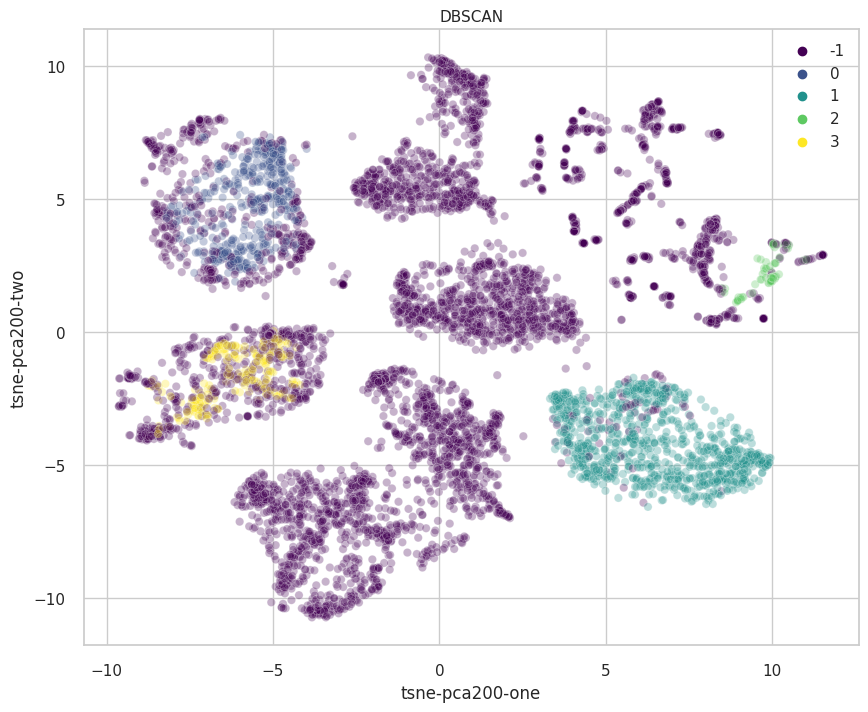

In [ ]:
#tsne para romper las pelotas
plt.figure(figsize=(10,8))
sns.set(style = 'whitegrid')
sns.scatterplot(
    x="tsne-pca200-one", y="tsne-pca200-two",
    hue=mejores_resultados_DBSCAN['labels'].loc[69],
    palette="viridis",
    data=features,
    legend="full",
    alpha=0.3
)
plt.title("DBSCAN", fontsize=11)
plt.savefig('tsne dbscan.png')

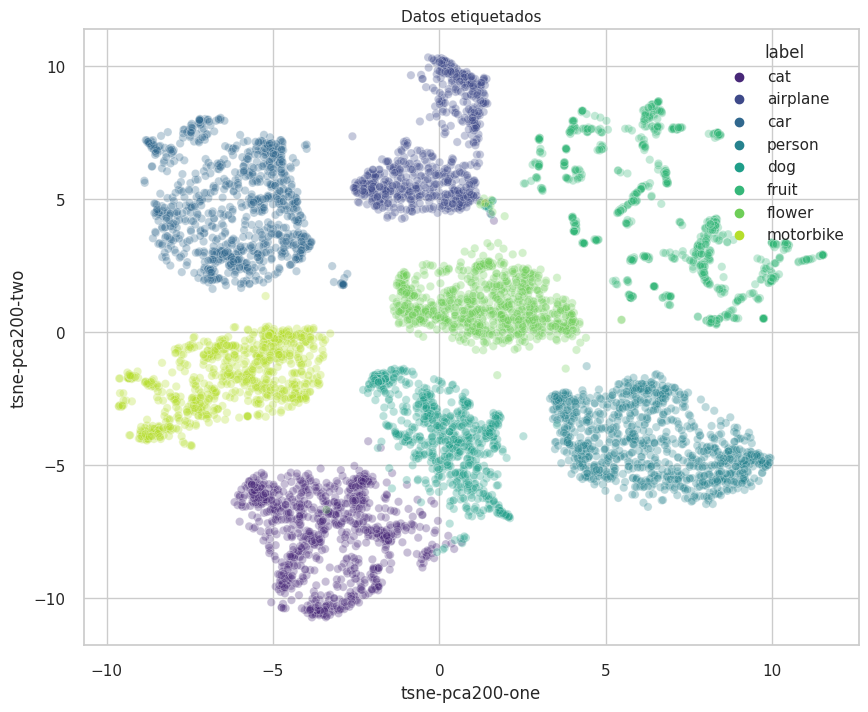

In [ ]:
#tsne para romper las pelotas
plt.figure(figsize=(10,8))
sns.set(style = 'whitegrid')
sns.scatterplot(
    x="tsne-pca200-one", y="tsne-pca200-two",
    hue=features['label'],
    palette="viridis",
    data=features,
    legend="full",
    alpha=0.3
)
plt.title("Datos etiquetados", fontsize=11)
plt.savefig('tsne datos etiquetados.png')

###DBSCAN escalado con standarscaler
Ya esta calculado y guardado en el drive un dataframe, como para no correrlo nuevamente en caso que no encuentren ningun error (toma un tiempito, unos 15min). Esta al final calculos para poder leerlo directamente

####Calculos

In [ ]:
from sklearn.cluster import DBSCAN
from sklearn.preprocessing import StandardScaler
import numpy as np

#Estandarizo X a ver si mejora la formacion de clusters
X_standard = StandardScaler().fit_transform(X)

eps_values = [0.1, 0.5, 1.0, 2, 5, 10, 20, 30, 40, 50]
min_samples_values = [2, 5, 10, 15, 20, 25, 50]

clustering_results_standard = {}  # Store the results for different combinations

for eps in eps_values:
    for min_samples in min_samples_values:
        # Perform DBSCAN clustering for the current combination of eps and min_samples
        clustering_DBSCAN_standard= DBSCAN(eps=eps, min_samples=min_samples).fit(X_standard)

        # Store the cluster labels in the results dictionary
        key = f'eps={eps}_min_samples={min_samples}'
        clustering_results_standard[key] = {
            'labels': clustering_DBSCAN_standard.labels_,
            'n_clusters': len(set(clustering_DBSCAN_standard.labels_)) - (1 if -1 in clustering_DBSCAN_standard.labels_ else 0),
            'n_noise': list(clustering_DBSCAN_standard.labels_).count(-1)
        }


        # Calculate the number of clusters (excluding noise)
        n_clusters_ = len(set(clustering_DBSCAN_standard.labels_)) - (1 if -1 in clustering_DBSCAN_standard.labels_ else 0)

        # Calculate the number of noise points
        n_noise_ = list(clustering_DBSCAN_standard.labels_).count(-1)

        # Print the results for the current combination
        print(f'eps={eps}, min_samples={min_samples}')
        print("Cluster labels:")
        print(clustering_DBSCAN_standard.labels_)
        print("Estimated number of clusters: %d" % n_clusters_)
        print("Estimated number of noise points: %d" % n_noise_)
        print()


eps=0.1, min_samples=2
Cluster labels:
[-1 -1 -1 ... -1 -1 -1]
Estimated number of clusters: 2
Estimated number of noise points: 6895

eps=0.1, min_samples=5
Cluster labels:
[-1 -1 -1 ... -1 -1 -1]
Estimated number of clusters: 0
Estimated number of noise points: 6899

eps=0.1, min_samples=10
Cluster labels:
[-1 -1 -1 ... -1 -1 -1]
Estimated number of clusters: 0
Estimated number of noise points: 6899

eps=0.1, min_samples=15
Cluster labels:
[-1 -1 -1 ... -1 -1 -1]
Estimated number of clusters: 0
Estimated number of noise points: 6899

eps=0.1, min_samples=20
Cluster labels:
[-1 -1 -1 ... -1 -1 -1]
Estimated number of clusters: 0
Estimated number of noise points: 6899

eps=0.1, min_samples=25
Cluster labels:
[-1 -1 -1 ... -1 -1 -1]
Estimated number of clusters: 0
Estimated number of noise points: 6899

eps=0.1, min_samples=50
Cluster labels:
[-1 -1 -1 ... -1 -1 -1]
Estimated number of clusters: 0
Estimated number of noise points: 6899

eps=0.5, min_samples=2
Cluster labels:
[-1 -1 -1 .

In [ ]:
df_DBSCAN_standard_results = pd.DataFrame(clustering_results_standard).T.reset_index().rename(columns={'index': 'parametros'})

In [ ]:
#Esto lo podria haber hecho antes, pero me acorde tarde y lo agregue dps..hay varias medidas que no las vimos y
#por ahi ni se usan pero era rapido el calculo (solo el silhouette demora)

#Medidas de validacion

# Assuming df_DBSCAN_standard_results.labels is a DataFrame column
labels_column = df_DBSCAN_standard_results['labels']

# Create empty lists to store the scores
homogeneity_scores = []
completeness_scores = []
v_measure_scores = []
adjusted_rand_scores = []
adjusted_mutual_info_scores = []
silhouette_coefficients = []

for labels in labels_column:
    homogeneity = metrics.homogeneity_score(features.label, labels)
    completeness = metrics.completeness_score(features.label, labels)
    v_measure = metrics.v_measure_score(features.label, labels)
    adjusted_rand = metrics.adjusted_rand_score(features.label, labels)
    adjusted_mutual_info = metrics.adjusted_mutual_info_score(features.label, labels)

    if len(set(labels)) == 1:
      silhouette = float('nan')
    else:
      silhouette = metrics.silhouette_score(X_standard, labels) #Silhoutte sobre los datos standarizados


    homogeneity_scores.append(homogeneity)
    completeness_scores.append(completeness)
    v_measure_scores.append(v_measure)
    adjusted_rand_scores.append(adjusted_rand)
    adjusted_mutual_info_scores.append(adjusted_mutual_info)
    silhouette_coefficients.append(silhouette)

# Add the scores as new columns to your DataFrame
df_DBSCAN_standard_results['homogeneity'] = homogeneity_scores
df_DBSCAN_standard_results['completeness'] = completeness_scores
df_DBSCAN_standard_results['v_measure'] = v_measure_scores
df_DBSCAN_standard_results['adjusted_rand'] = adjusted_rand_scores
df_DBSCAN_standard_results['adjusted_mutual_info'] = adjusted_mutual_info_scores
df_DBSCAN_standard_results['silhouette'] = silhouette_coefficients

In [ ]:
df_DBSCAN_standard_results.to_pickle(path_repo+'clustering_results_standard.pkg')

In [ ]:
df_DBSCAN_standard_results = pd.read_pickle(path_repo+'clustering_results_standard.pkg')

####Resultados

In [ ]:
df_DBSCAN_standard_results[df_DBSCAN_standard_results.n_clusters.isin([3,4,5,6,7,8])].sort_values(by='silhouette', ascending=False)

,parametros,labels,n_clusters,n_noise,homogeneity,completeness,v_measure,adjusted_rand,adjusted_mutual_info,silhouette
67,eps=50_min_samples=20,"[-1, -1, 0, -1, -1, -1, -1, -1, -1, -1, 0, -1,...",7,3528,0.458638,0.655944,0.539827,0.237385,0.538877,-0.004614
68,eps=50_min_samples=25,"[-1, -1, 0, -1, -1, -1, -1, -1, -1, -1, 0, -1,...",6,3659,0.440990,0.656695,0.527648,0.223498,0.526812,-0.005992
69,eps=50_min_samples=50,"[-1, -1, 0, -1, -1, -1, -1, -1, -1, -1, 0, -1,...",6,4013,0.394655,0.653634,0.492155,0.192148,0.491214,-0.026263
51,eps=30_min_samples=10,"[-1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -...",8,6784,0.015957,0.278039,0.030182,-0.000771,0.025963,-0.100507
59,eps=40_min_samples=15,"[-1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -...",6,5813,0.159808,0.498963,0.242082,0.022035,0.240345,-0.110551
43,eps=20_min_samples=5,"[-1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -...",5,6868,0.004219,0.244058,0.008294,-0.000325,0.005551,-0.112467
60,eps=40_min_samples=20,"[-1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -...",6,5905,0.146287,0.493140,0.225640,0.019492,0.223829,-0.117832
61,eps=40_min_samples=25,"[-1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -...",6,6003,0.132091,0.490283,0.208113,0.017418,0.206207,-0.127199
35,eps=10_min_samples=2,"[-1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -...",6,6887,0.001658,0.215841,0.003290,-0.000097,0.000848,-0.201718


##### matriz de confusión

In [ ]:
#Para guardar todas las matrices en un diccionario para luego verlas individualmente
mejores_resultados_DBSCAN_standard = df_DBSCAN_standard_results[df_DBSCAN_standard_results.n_clusters.isin([3,4,5,6,7,8])].sort_values(by='silhouette', ascending=False)
matriz_DBSCAN_standard_results = {}

for index, row in mejores_resultados_DBSCAN_standard.iterrows():
  k = mejores_resultados_DBSCAN_standard.parametros[index]
  confusion_matrix = pd.crosstab(row['labels'], features['label'], rownames=['clusters'])
  matriz_DBSCAN_standard_results[f'matriz_DBSCAN_standard_results_{k}'] = confusion_matrix

In [ ]:
#elegir que matriz ver
matriz_DBSCAN_standard_results_k = mejores_resultados_DBSCAN_standard.parametros.iloc[0]
matriz_DBSCAN_standard_results[f'matriz_DBSCAN_standard_results_{matriz_DBSCAN_standard_results_k}']

label,airplane,car,cat,dog,flower,fruit,motorbike,person
clusters,,,,,,,,
-1,491,240,680,701,674,459,187,96
0,0,0,205,0,0,0,0,0
1,236,0,0,0,0,0,0,0
2,0,728,0,1,0,0,601,0
3,0,0,0,0,0,0,0,890
4,0,0,0,0,0,519,0,0
5,0,0,0,0,0,22,0,0
6,0,0,0,0,169,0,0,0


##### van Dongen

In [ ]:
for i in range(len(matriz_DBSCAN_standard_results)):
  matriz = matriz_DBSCAN_standard_results[f'matriz_DBSCAN_standard_results_{mejores_resultados_DBSCAN_standard.parametros.iloc[i]}']
  vd = vanDongen(matriz)
  print(f'van Dongen k={mejores_resultados_DBSCAN_standard.parametros.iloc[i]} --> {vd}')

van Dongen k=eps=50_min_samples=20 --> 0.5441208198489752
van Dongen k=eps=50_min_samples=25 --> 0.5602363497100339
van Dongen k=eps=50_min_samples=50 --> 0.5859988616960728
van Dongen k=eps=30_min_samples=10 --> 0.9832058530096441
van Dongen k=eps=40_min_samples=15 --> 0.8555476020042949
van Dongen k=eps=20_min_samples=5 --> 0.997133220910624
van Dongen k=eps=40_min_samples=20 --> 0.8704482808646453
van Dongen k=eps=40_min_samples=25 --> 0.8850625459896984
van Dongen k=eps=10_min_samples=2 --> 0.9986465911013365


##### Grafico

In [ ]:
import seaborn as sns

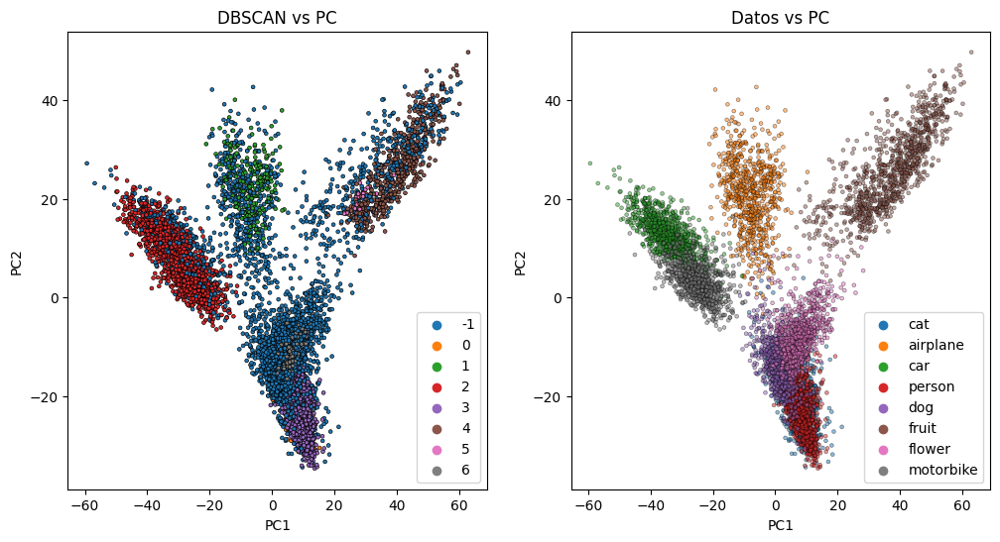

In [ ]:
fig, ax = plt.subplots(1,2, figsize=(12,6))
sns.scatterplot(x=X_PCA[:,0], y=X_PCA[:,1], marker=".", s=30, lw=0, edgecolor="k", alpha = 1, hue=mejores_resultados_DBSCAN_standard['labels'].iloc[0], palette='tab10', ax=ax[0])
ax[0].set_xlabel('PC1')
ax[0].set_ylabel('PC2')
ax[0].set_title('DBSCAN vs PC')
ax[0].set_title('DBSCAN vs PC')
ax[0].legend(loc='lower right')
sns.scatterplot(x=X_PCA[:,0], y=X_PCA[:,1], marker=".", s=30, lw=0, edgecolor="k", alpha = 0.5, hue=features['label'], palette='tab10', ax=ax[1])
ax[1].set_xlabel('PC1')
ax[1].set_ylabel('PC2')
ax[1].set_title('Datos vs PC')
ax[1].legend(loc='lower right')

plt.show()

###DBSCAN PCA (80% varianza)
Ya esta calculado y guardado en el drive un dataframe, como para no correrlo nuevamente en caso que no encuentren ningun error (toma un tiempito, unos 15min). Esta al final calculos para poder leerlo directamente

####Calculos

In [ ]:
from sklearn.cluster import DBSCAN
from sklearn.preprocessing import StandardScaler
import numpy as np

X = np.array(features.drop(columns=['path','label']))

pca = PCA(n_components=.8, random_state=42)
pca.fit(X)

X_PCA = pca.transform(X)

eps_values = [0.1, 0.5, 1.0, 2, 5, 10, 20, 30, 40, 50]
min_samples_values = [2, 5, 10, 15, 20, 25, 50]

clustering_results_PCA = {}  # Store the results for different combinations

for eps in eps_values:
    for min_samples in min_samples_values:
        # Perform DBSCAN clustering for the current combination of eps and min_samples
        clustering_DBSCAN_PCA = DBSCAN(eps=eps, min_samples=min_samples).fit(X_PCA)

        # Store the cluster labels in the results dictionary
        key = f'eps={eps}_min_samples={min_samples}'
        clustering_results_PCA[key] = {
            'labels': clustering_DBSCAN_PCA.labels_,
            'n_clusters': len(set(clustering_DBSCAN_PCA.labels_)) - (1 if -1 in clustering_DBSCAN_PCA.labels_ else 0),
            'n_noise': list(clustering_DBSCAN_PCA.labels_).count(-1)
        }

        # Calculate the number of clusters (excluding noise)
        n_clusters_ = len(set(clustering_DBSCAN_PCA.labels_)) - (1 if -1 in clustering_DBSCAN_PCA.labels_ else 0)

        # Calculate the number of noise points
        n_noise_ = list(clustering_DBSCAN_PCA.labels_).count(-1)

        # Print the results for the current combination
        print(f'eps={eps}, min_samples={min_samples}')
        print("Cluster labels:")
        print(clustering_DBSCAN_PCA.labels_)
        print("Estimated number of clusters: %d" % n_clusters_)
        print("Estimated number of noise points: %d" % n_noise_)
        print()


eps=0.1, min_samples=2
Cluster labels:
[-1 -1 -1 ... -1 -1 -1]
Estimated number of clusters: 2
Estimated number of noise points: 6895

eps=0.1, min_samples=5
Cluster labels:
[-1 -1 -1 ... -1 -1 -1]
Estimated number of clusters: 0
Estimated number of noise points: 6899

eps=0.1, min_samples=10
Cluster labels:
[-1 -1 -1 ... -1 -1 -1]
Estimated number of clusters: 0
Estimated number of noise points: 6899

eps=0.1, min_samples=15
Cluster labels:
[-1 -1 -1 ... -1 -1 -1]
Estimated number of clusters: 0
Estimated number of noise points: 6899

eps=0.1, min_samples=20
Cluster labels:
[-1 -1 -1 ... -1 -1 -1]
Estimated number of clusters: 0
Estimated number of noise points: 6899

eps=0.1, min_samples=25
Cluster labels:
[-1 -1 -1 ... -1 -1 -1]
Estimated number of clusters: 0
Estimated number of noise points: 6899

eps=0.1, min_samples=50
Cluster labels:
[-1 -1 -1 ... -1 -1 -1]
Estimated number of clusters: 0
Estimated number of noise points: 6899

eps=0.5, min_samples=2
Cluster labels:
[-1 -1 -1 .

In [ ]:
df_DBSCAN_PCA_results = pd.DataFrame(clustering_results_PCA).T.reset_index().rename(columns={'index': 'parametros'})

In [ ]:
#Esto lo podria haber hecho antes, pero me acorde tarde y lo agregue dps..hay varias medidas que no las vimos y
#por ahi ni se usan pero era rapido el calculo (solo el silhouette demora)

#Medidas de validacion
# Assuming df_DBSCAN_PCA_results.labels is a DataFrame column
labels_column = df_DBSCAN_PCA_results['labels']

# Create empty lists to store the scores
homogeneity_scores = []
completeness_scores = []
v_measure_scores = []
adjusted_rand_scores = []
adjusted_mutual_info_scores = []
silhouette_coefficients = []

for labels in labels_column:
    homogeneity = sklearn.metrics.homogeneity_score(features.label, labels)
    completeness = sklearn.metrics.completeness_score(features.label, labels)
    v_measure = sklearn.metrics.v_measure_score(features.label, labels)
    adjusted_rand = sklearn.metrics.adjusted_rand_score(features.label, labels)
    adjusted_mutual_info = sklearn.metrics.adjusted_mutual_info_score(features.label, labels)

    if len(set(labels)) == 1:
      silhouette = float('nan')
    else:
      silhouette = sklearn.metrics.silhouette_score(X, labels) #Debiera hacerlo con los valores de PCA o con los datos crudos??


    homogeneity_scores.append(homogeneity)
    completeness_scores.append(completeness)
    v_measure_scores.append(v_measure)
    adjusted_rand_scores.append(adjusted_rand)
    adjusted_mutual_info_scores.append(adjusted_mutual_info)
    silhouette_coefficients.append(silhouette)

# Add the scores as new columns to your DataFrame
df_DBSCAN_PCA_results['homogeneity'] = homogeneity_scores
df_DBSCAN_PCA_results['completeness'] = completeness_scores
df_DBSCAN_PCA_results['v_measure'] = v_measure_scores
df_DBSCAN_PCA_results['adjusted_rand'] = adjusted_rand_scores
df_DBSCAN_PCA_results['adjusted_mutual_info'] = adjusted_mutual_info_scores
df_DBSCAN_PCA_results['silhouette'] = silhouette_coefficients

In [ ]:
#Calculo el silhouette pero como datos, los valores de PCA
#Medidas de validacion
# Assuming df_DBSCAN_PCA_results.labels is a DataFrame column
labels_column = df_DBSCAN_PCA_results['labels']

# Create empty lists to store the scores
silhouette_coefficients = []

for labels in labels_column:
    if len(set(labels)) == 1:
      silhouette = float('nan')
    else:
      silhouette = sklearn.metrics.silhouette_score(X_PCA, labels) #Hecho con el PCA

    silhouette_coefficients.append(silhouette)

# Add the scores as new columns to your DataFrame
df_DBSCAN_PCA_results['silhouette_PCA(X)'] = silhouette_coefficients

In [ ]:
df_DBSCAN_PCA_results.to_pickle(path_repo+'clustering_results_PCA.pkg')

In [ ]:
df_DBSCAN_PCA_results = pd.read_pickle(path_repo+'clustering_results_PCA.pkg')

####Resultados

In [ ]:
df_DBSCAN_PCA_results[df_DBSCAN_PCA_results.n_clusters.isin([3,4,5,6,7,8])].sort_values(by='silhouette', ascending=False)

,parametros,labels,n_clusters,n_noise,homogeneity,completeness,v_measure,adjusted_rand,adjusted_mutual_info,silhouette,silhouette_PCA(X)
66,eps=50_min_samples=15,"[0, 0, 0, 0, 0, 0, 0, 0, 0, -1, 0, 0, 0, 0, 0,...",5,654,0.199968,0.583624,0.297875,0.085437,0.296476,0.110686,0.127715
62,eps=40_min_samples=50,"[0, -1, -1, -1, -1, -1, -1, -1, -1, -1, 0, -1,...",8,4128,0.455556,0.695759,0.550600,0.210730,0.549523,-0.027609,-0.015657
44,eps=20_min_samples=10,"[-1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -...",5,6838,0.008359,0.267551,0.016211,-0.000551,0.013437,-0.057400,-0.030845
53,eps=30_min_samples=20,"[-1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -...",6,5932,0.163309,0.675789,0.263049,0.056790,0.261178,-0.094448,-0.086725
28,eps=5_min_samples=2,"[-1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -...",3,6893,0.000840,0.218662,0.001673,-0.000035,0.000447,-0.106039,-0.117924


In [ ]:
print('% no clasificado:',round(df_DBSCAN_PCA_results[df_DBSCAN_PCA_results.n_clusters.isin([3,4,5,6,7,8])].sort_values(by='silhouette', ascending=False).iloc[0,3]/X.shape[0]*100,2))

% no clasificado: 9.48


##### matriz de confusión

In [ ]:
#Para guardar todas las matrices en un diccionario para luego verlas individualmente
mejores_resultados_DBSCAN_PCA = df_DBSCAN_PCA_results[df_DBSCAN_PCA_results.n_clusters.isin([3,4,5,6,7,8])].sort_values(by='silhouette', ascending=False)
matriz_DBSCAN_PCA_results = {}

for index, row in mejores_resultados_DBSCAN_PCA.iterrows():
  k = mejores_resultados_DBSCAN_PCA.parametros[index]
  confusion_matrix = pd.crosstab(row['labels'], features['label'], rownames=['clusters'])
  matriz_DBSCAN_PCA_results[f'matriz_DBSCAN_PCA_results_{k}'] = confusion_matrix

In [ ]:
#elegir que matriz ver
matriz_DBSCAN_PCA_results_k = mejores_resultados_DBSCAN_PCA.parametros.loc[66]
matriz_DBSCAN_PCA_results[f'matriz_DBSCAN_PCA_results_{matriz_DBSCAN_PCA_results_k}']

label,airplane,car,cat,dog,flower,fruit,motorbike,person
clusters,,,,,,,,
-1,46,3,88,177,180,152,7,1
0,681,965,797,525,663,0,781,985
1,0,0,0,0,0,796,0,0
2,0,0,0,0,0,18,0,0
3,0,0,0,0,0,18,0,0
4,0,0,0,0,0,16,0,0


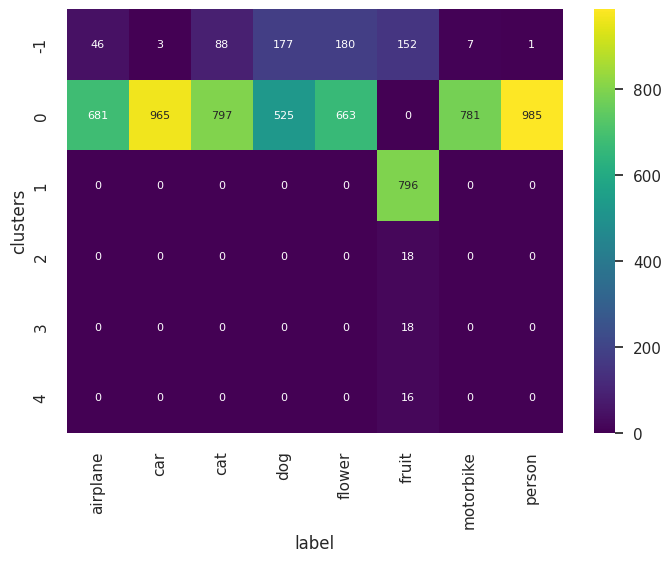

In [ ]:
df_conf = matriz_DBSCAN_PCA_results[f'matriz_DBSCAN_PCA_results_{matriz_DBSCAN_PCA_results_k}']

# plt.figure(figsize=(10,7))
sn.set(font_scale=1) # for label size
sn.heatmap(df_conf, annot=True, annot_kws={"size": 8}, cmap = 'viridis',fmt='g') # font size
plt.savefig('matriz_conf_DBSCAN PCA EXP 1.png')
plt.show()

In [ ]:
#elegir que matriz ver
matriz_DBSCAN_PCA_results_k = mejores_resultados_DBSCAN_PCA.parametros.loc[62]
matriz_DBSCAN_PCA_results[f'matriz_DBSCAN_PCA_results_{matriz_DBSCAN_PCA_results_k}']

label,airplane,car,cat,dog,flower,fruit,motorbike,person
clusters,,,,,,,,
-1,529,328,692,700,734,896,243,6
0,0,0,193,0,1,0,0,0
1,87,0,0,0,0,0,0,0
2,111,0,0,0,0,0,0,0
3,0,640,0,0,0,0,0,0
4,0,0,0,2,0,0,0,980
5,0,0,0,0,0,104,0,0
6,0,0,0,0,108,0,0,0
7,0,0,0,0,0,0,545,0


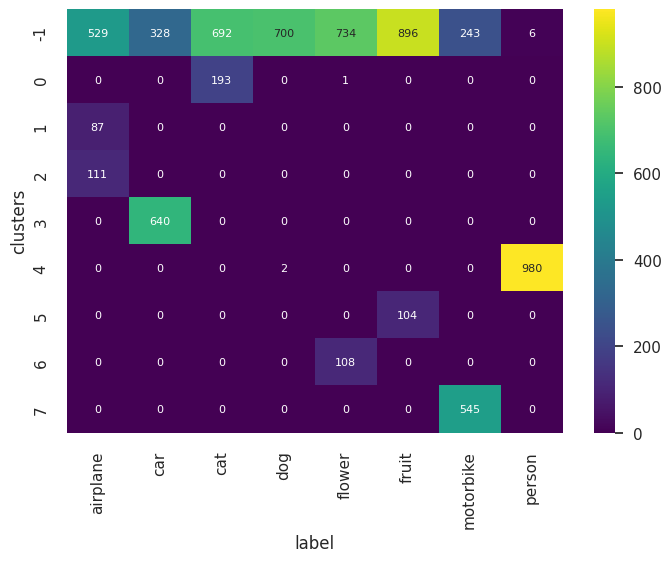

In [ ]:
df_conf = matriz_DBSCAN_PCA_results[f'matriz_DBSCAN_PCA_results_{matriz_DBSCAN_PCA_results_k}']

# plt.figure(figsize=(10,7))
sn.set(font_scale=1) # for label size
sn.heatmap(df_conf, annot=True, annot_kws={"size": 8}, cmap = 'viridis',fmt='g') # font size
plt.savefig('matriz_conf_DBSCAN PCA EXP 2.png')
plt.show()

##### van Dongen

In [ ]:
for i in range(len(matriz_DBSCAN_PCA_results)):
  matriz = matriz_DBSCAN_PCA_results[f'matriz_DBSCAN_PCA_results_{mejores_resultados_DBSCAN_PCA.parametros.iloc[i]}']
  vd = vanDongen(matriz)
  print(f'van Dongen k={mejores_resultados_DBSCAN_PCA.parametros.iloc[i]} --> {vd}')

van Dongen k=eps=50_min_samples=15 --> 0.7555735711390352
van Dongen k=eps=40_min_samples=50 --> 0.5095732410611303
van Dongen k=eps=20_min_samples=10 --> 0.9921140939597315
van Dongen k=eps=30_min_samples=20 --> 0.7755607340518497
van Dongen k=eps=5_min_samples=2 --> 0.9993226079593565


##### Grafico

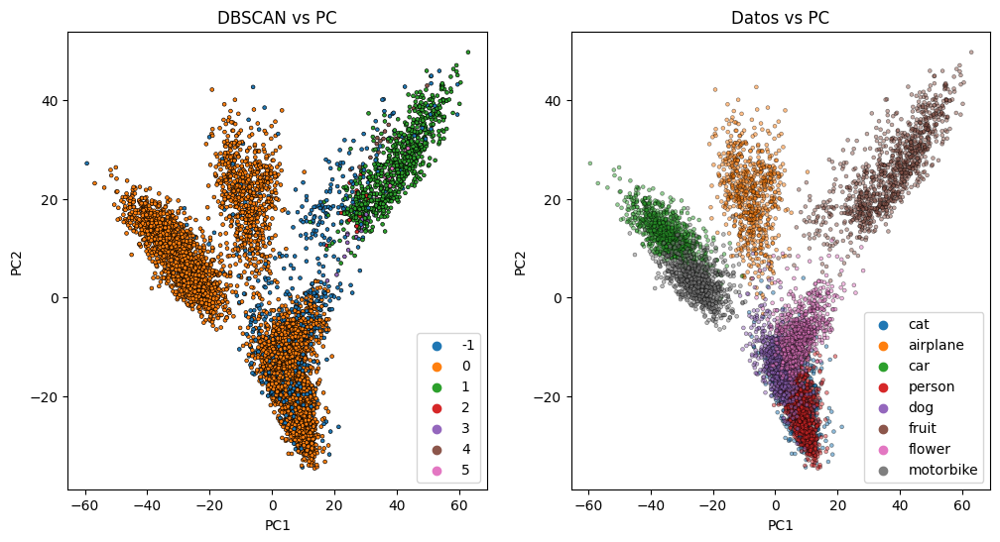

In [ ]:
fig, ax = plt.subplots(1,2, figsize=(12,6))
sns.scatterplot(x=X_PCA[:,0], y=X_PCA[:,1], marker=".", s=30, lw=0, edgecolor="k", alpha = 1, hue=mejores_resultados_DBSCAN_PCA['labels'].iloc[0], palette='tab10', ax=ax[0])
ax[0].set_xlabel('PC1')
ax[0].set_ylabel('PC2')
ax[0].set_title('DBSCAN vs PC')
ax[0].set_title('DBSCAN vs PC')
ax[0].legend(loc='lower right')
sns.scatterplot(x=X_PCA[:,0], y=X_PCA[:,1], marker=".", s=30, lw=0, edgecolor="k", alpha = 0.5, hue=features['label'], palette='tab10', ax=ax[1])
ax[1].set_xlabel('PC1')
ax[1].set_ylabel('PC2')
ax[1].set_title('Datos vs PC')
ax[1].legend(loc='lower right')

plt.show()

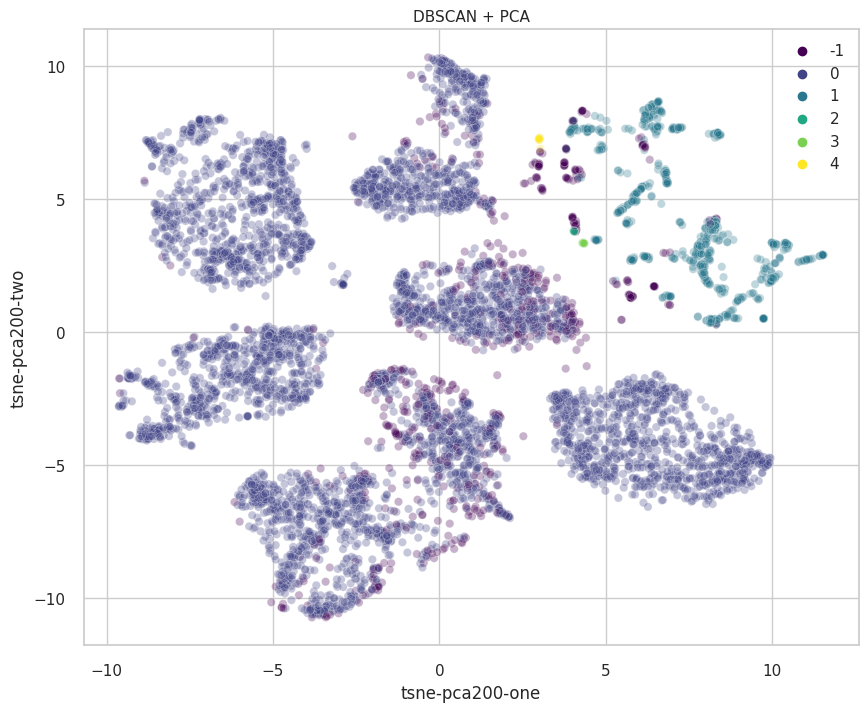

In [ ]:
#tsne para romper las pelotas
plt.figure(figsize=(10,8))
sns.set(style = 'whitegrid')
sns.scatterplot(
    x="tsne-pca200-one", y="tsne-pca200-two",
    hue=mejores_resultados_DBSCAN_PCA['labels'].loc[66],
    palette="viridis",
    data=features,
    legend="full",
    alpha=0.3
)
plt.title("DBSCAN + PCA", fontsize=11)
plt.savefig('tsne dbscan PCA exp 1.png')

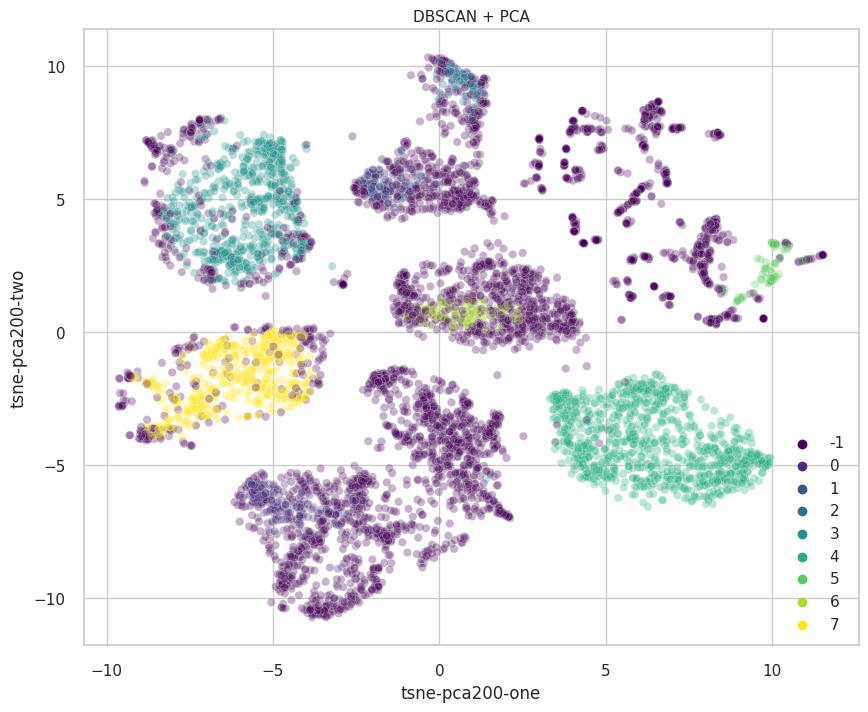

In [ ]:
#tsne para romper las pelotas
plt.figure(figsize=(10,8))
sns.set(style = 'whitegrid')
sns.scatterplot(
    x="tsne-pca200-one", y="tsne-pca200-two",
    hue=mejores_resultados_DBSCAN_PCA['labels'].loc[62],
    palette="viridis",
    data=features,
    legend="full",
    alpha=0.3
)
plt.title("DBSCAN + PCA", fontsize=11)
plt.savefig('tsne dbscan PCA exp 2.png')

## HDBSCAN

Probe algunas cosas y el que mejor anduvo fue este (visualmente). min_cluster_size=20, min_samples=5, distancia='manhattan'

In [ ]:
!pip install hdbscan

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.2/5.2 MB 35.8 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
  Using cached Cython-0.29.36-cp310-cp310-manylinux_2_17_x86_64.manylinux2014_x86_64.manylinux_2_24_x86_64.whl (1.9 MB)
  Created wheel for hdbscan: filename=hdbscan-0.8.33-cp310-cp310-linux_x86_64.whl size=3039177 sha256=83cd6d6e8dd8bd70c44e3a7ba4c3ac1ca256c76080015e9965f48622596fe508
  Stored in directory: /root/.cache/pip/wheels/75/0b/3b/dc4f60b7cc455efaefb62883a7483e76f09d06ca81cf87d610
Successfully built hdbscan
  Attempting uninstall: cython
    Found existing installation: Cython 3.0.2
    Uninstalling Cython-3.0.2:
      Successfully uninstalled Cython-3.0.2


In [ ]:
import matplotlib.pyplot as plt
import hdbscan
import numpy as np

#X = np.array(features.iloc[:, :-1])
X = np.array(features.drop(columns=['path','label']))

# Your PARAM values
# PARAM = (
#     {"min_cluster_size": 20, "min_samples": 3},
#     {"min_cluster_size": 20, "min_samples": 5},
#     {"min_cluster_size": 20, "min_samples": 25},
# )

# Iterate over PARAM and plot for each parameter set
hdb = hdbscan.HDBSCAN(**{"min_cluster_size": 20, "min_samples": 5}, metric='manhattan').fit(X)
labels = hdb.labels_

In [ ]:
silhouette = metrics.silhouette_score(X, labels)
adjusted_rand = metrics.adjusted_rand_score(features.label, labels)
print(f'silhouette-->{silhouette}')
print(f'ARI-->{adjusted_rand}')

silhouette-->0.028816770762205124
ARI-->0.2929772546434295


In [ ]:
matriz_HDBSCAN = pd.crosstab(labels, features['label'], rownames=['clusters'])
matriz_HDBSCAN

label,airplane,car,cat,dog,flower,fruit,motorbike,person
clusters,,,,,,,,
-1,213,515,672,642,483,203,327,125
0,514,0,0,3,0,0,0,0
1,0,0,0,0,0,797,0,0
2,0,0,0,0,359,0,0,0
3,0,0,213,0,1,0,0,0
4,0,0,0,57,0,0,0,0
5,0,0,0,0,0,0,0,861
6,0,0,0,0,0,0,461,0
7,0,453,0,0,0,0,0,0


In [ ]:
def vanDongen(ct):
    n2=2*(sum(ct.apply(sum,axis=1)))
    sumi = sum(ct.apply(np.max,axis=1))
    sumj = sum(ct.apply(np.max,axis=0))
    maxsumi = np.max(ct.apply(sum,axis=1))
    maxsumj = np.max(ct.apply(sum,axis=0))
    vd = (n2 - sumi - sumj)/(n2 - maxsumi - maxsumj)
    return vd

In [ ]:
vd = vanDongen(matriz_HDBSCAN)
print(f'van Dongen --> {vd}')

van Dongen --> 0.4643377001455604


In [ ]:
#tsne para romper las pelotas

pca_tsne = PCA(random_state=42,n_components=0.8)
pca_mtx1_tsne = pca_tsne.fit_transform(np.array(X))

#varianza total explicada
print('Varianza total explicada: ', np.sum(pca_tsne.explained_variance_ratio_))

from sklearn.manifold import TSNE
tsne = TSNE(n_components=2, verbose=0, perplexity=40, n_iter=300)
tsne_pca_results = tsne.fit_transform(pca_mtx1_tsne)

features['tsne-pca200-one'] = tsne_pca_results[:,0]
features['tsne-pca200-two'] = tsne_pca_results[:,1]
#features['tsne-pca200-three'] = tsne_pca_results[:,2]


Varianza total explicada:  0.8003952


### Grafico tsne solo para los datos clusterizados

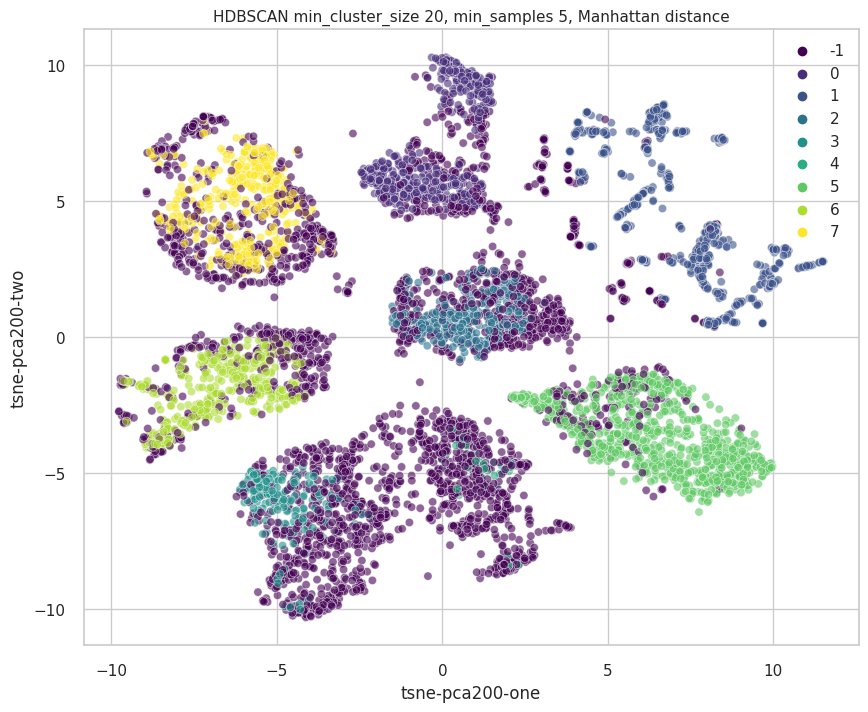

In [ ]:
import seaborn as sns
plt.figure(figsize=(10,8))
sns.set(style='whitegrid')
sns.scatterplot(
    x="tsne-pca200-one", y="tsne-pca200-two",
    hue=labels,
    palette="viridis",
    data=features,
    legend="full",
    alpha=0.6
)

plt.title(f"HDBSCAN min_cluster_size 20, min_samples 5, Manhattan distance", fontsize=11)
plt.show()
#plt.savefig('tsne kmeans k = 6.png')

### Grafico tsne para los datos clusterizados y los originales

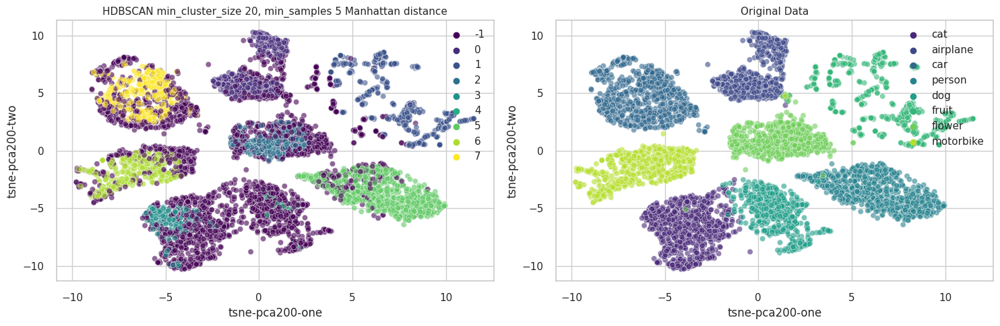

In [ ]:
import seaborn as sns

fig, axes = plt.subplots(1, 2, figsize=(15, 5))
sns.set(style='whitegrid')
sns.scatterplot(
    x="tsne-pca200-one", y="tsne-pca200-two",
    hue=labels,
    palette="viridis",
    data=features,
    legend="full",
    alpha=0.6,
    ax = axes[0]
)
axes[0].legend(loc='upper right')
axes[0].set_title(f"HDBSCAN min_cluster_size 20, min_samples 5 Manhattan distance", fontsize=11)

sns.scatterplot(
    x="tsne-pca200-one", y="tsne-pca200-two",
    hue=features.label,
    palette="viridis",
    data=features,
    alpha=0.6,
    ax = axes[1]
)

axes[1].set_title(f"Original Data", fontsize=11)
axes[1].legend(loc='upper right').set_title('')
plt.tight_layout()
#plt.savefig('tsne kmeans k = 6.png')
plt.show()

### Grafico tsne para los datos clusterizados y los originales marcando los noise (-1) con otro tamaño y color

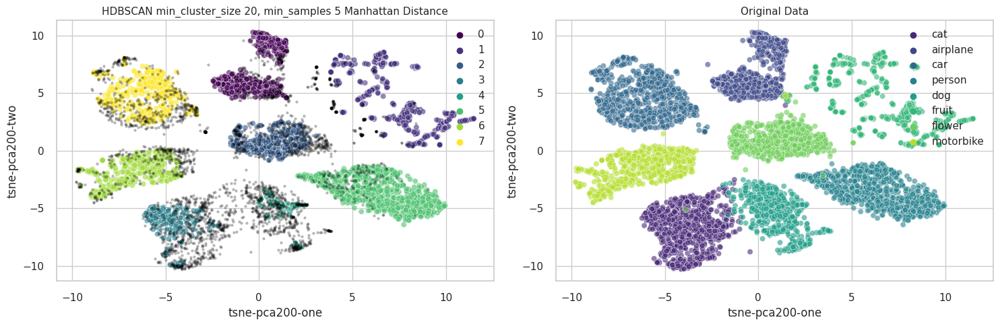

In [ ]:
import seaborn as sns

# Create a mask for points with labels == -1
mask = labels == -1

fig, axes = plt.subplots(1, 2, figsize=(15, 5))
sns.set(style='whitegrid')

# Plot points with labels other than -1
sns.scatterplot(
    x="tsne-pca200-one", y="tsne-pca200-two",
    hue=labels[~mask],  # Use the mask to filter out labels==-1
    palette="viridis",
    data=features[~mask],  # Use the mask to filter out labels==-1
    legend="full",
    alpha=0.6,
    ax=axes[0]
)

axes[0].scatter(
    features[mask]["tsne-pca200-one"],
    features[mask]["tsne-pca200-two"],
    c="black",
    s=5,  # Set the size of black dots
    alpha=0.2,
)


axes[0].legend(loc='upper right')
axes[0].set_title(f"HDBSCAN min_cluster_size 20, min_samples 5 Manhattan Distance", fontsize=11)

# Plot points with labels == -1 with different size and color
sns.scatterplot(
    x="tsne-pca200-one", y="tsne-pca200-two",
    hue=features.label,
    palette="viridis",
    data=features,
    alpha=0.6,
    ax = axes[1]
)

axes[1].set_title(f"Original Data", fontsize=11)
axes[1].legend(loc='upper right').set_title('')
plt.tight_layout()
plt.show()


# Detección de objetos dentro de una imagen

Se propone detectar un objeto dentro de una imágen siguiendo los siguientes pasos.

## a. Seleccionar una sóla imagen.

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
imagenes = pd.read_csv(path_repo+'TP1_procesado.csv')

## b. Convertir la imagen a binaria

## c. Aplicar los algoritmos de Connected-component labelling y clustering espectral sobre los pixels

###Connected-component labelling
Encontre esto en la web, medio pedorro, pero anda e identifica algunas cosas

In [ ]:
def connected_component_label(path):
    # Getting the input image in color mode
    img = cv2.imread(path, cv2.IMREAD_COLOR)

    # Convert the input image to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    # Converting those pixels with values 1-127 to 0 and others to 1
    binary = cv2.threshold(gray, 127, 255, cv2.THRESH_BINARY)[1]

    # Applying cv2.connectedComponents()
    num_labels, labels = cv2.connectedComponents(binary)

    # Map component labels to hue val, 0-179 is the hue range in OpenCV
    label_hue = np.uint8(179*labels/np.max(labels))
    blank_ch = 255*np.ones_like(label_hue)
    labeled_img = cv2.merge([label_hue, blank_ch, blank_ch])

    # Converting cvt to BGR
    labeled_img = cv2.cvtColor(labeled_img, cv2.COLOR_HSV2BGR)

    # set bg label to black
    labeled_img[label_hue==0] = 0

    # Create a single figure with one row and three columns
    plt.figure(figsize=(15, 5))

    # Original Image
    plt.subplot(131)
    plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    plt.axis("off")
    plt.title("Original Image")

    # Binary Image
    plt.subplot(132)
    plt.imshow(binary, cmap='gray')
    plt.axis("off")
    plt.title("Binary Image")

    # Labeled Image
    plt.subplot(133)
    plt.imshow(cv2.cvtColor(labeled_img, cv2.COLOR_BGR2RGB))
    plt.axis('off')
    plt.title("Image after Component Labeling")

    plt.tight_layout()
    plt.show()

In [ ]:
connected_component_label(features[feat])

NameError: ignored

<ipython-input-12-eebffa48f4b8>:15: RuntimeWarning: invalid value encountered in divide
  label_hue = np.uint8(179*labels/np.max(labels))


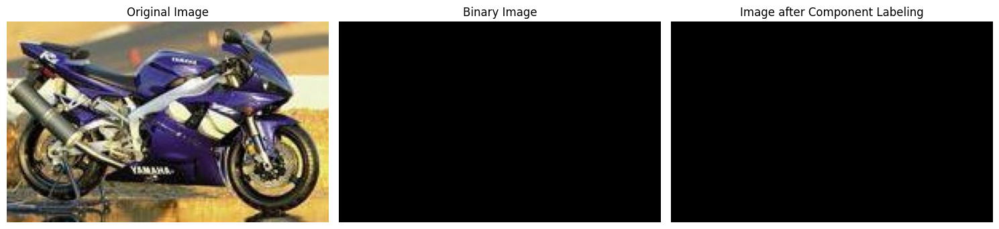

In [ ]:
#Aplico la funcion a alguna de las imagenes
connected_component_label(imagenes[imagenes.category=='motorbike'].iloc[77]['path'])

###Connected-component labelling (ESTE ES EL QUE ANDA!!)

La funcion **connected_component_label(path, use_inverted_binary=False, threshold_value=127, save_path=None)** toma la imagen, se elige como se binariza, se elige donde poner el threshold

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

def connected_component_label(path, use_inverted_binary=False, threshold_value=127, save_path=None):
    # Getting the input image in color mode
    img = cv2.imread(path, cv2.IMREAD_COLOR)

    # Convert the input image to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    # Apply binary thresholding based on the use_inverted_binary parameter and threshold_value
    if use_inverted_binary:
        binary = cv2.threshold(gray, threshold_value, 255, cv2.THRESH_BINARY_INV)[1]
    else:
        binary = cv2.threshold(gray, threshold_value, 255, cv2.THRESH_BINARY)[1]

    # Applying cv2.connectedComponents()
    num_labels, labels = cv2.connectedComponents(binary)

    # Map component labels to hue val, 0-179 is the hue range in OpenCV
    label_hue = np.uint8(179*labels/np.max(labels))
    blank_ch = 255*np.ones_like(label_hue)
    labeled_img = cv2.merge([label_hue, blank_ch, blank_ch])

    # Converting cvt to BGR
    labeled_img = cv2.cvtColor(labeled_img, cv2.COLOR_HSV2BGR)

    # Set bg label to black
    labeled_img[label_hue==0] = 0

    # Create a single figure with one row and three columns
    plt.figure(figsize=(15, 5))

    # Original Image
    plt.subplot(131)
    plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    plt.axis("off")
    plt.title("Original Image")

    # Binary Image
    plt.subplot(132)
    plt.imshow(binary, cmap='gray')
    plt.axis("off")
    plt.title(f"Binary Image threshold_value = {threshold_value}")

    # Labeled Image
    plt.subplot(133)
    plt.imshow(cv2.cvtColor(labeled_img, cv2.COLOR_BGR2RGB))
    plt.axis('off')
    plt.title("Image after Component Labeling")

    plt.tight_layout()

    if save_path:
        plt.savefig(save_path, bbox_inches='tight', pad_inches=0.1)

    plt.show()

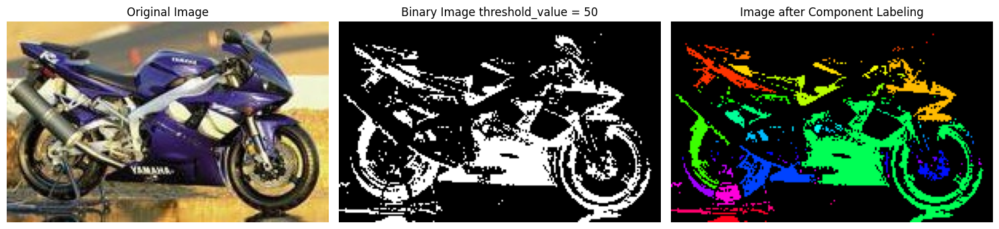

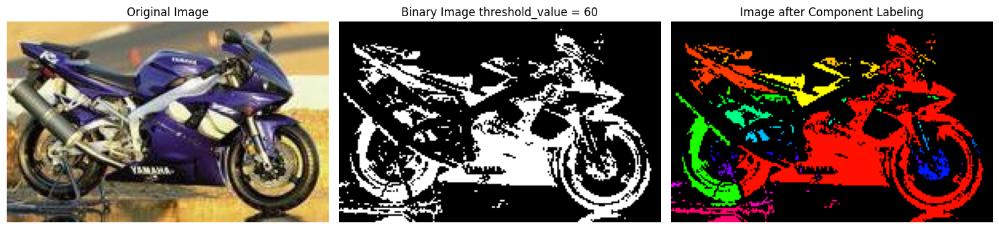

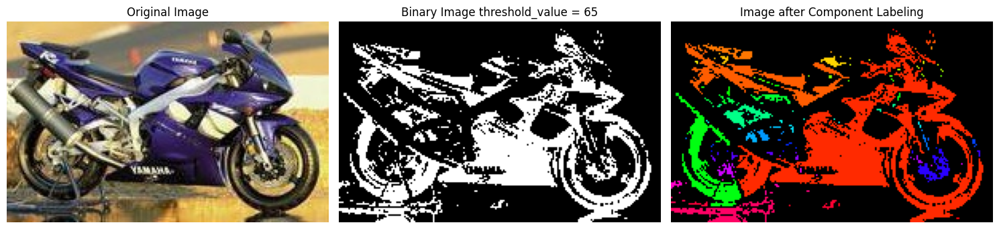

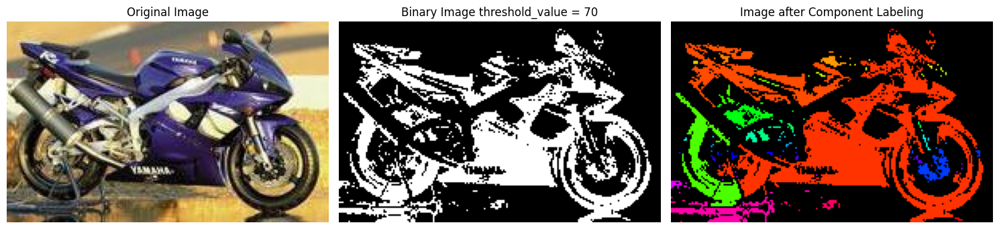

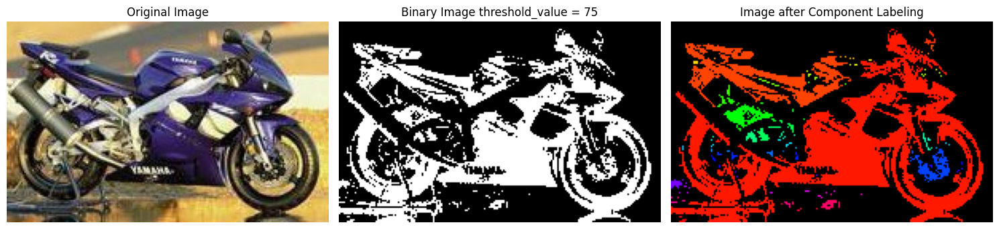

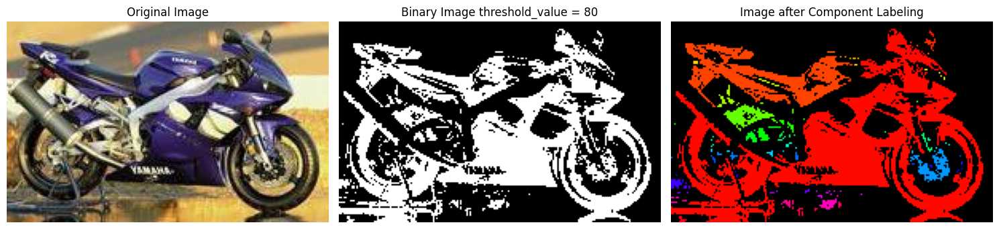

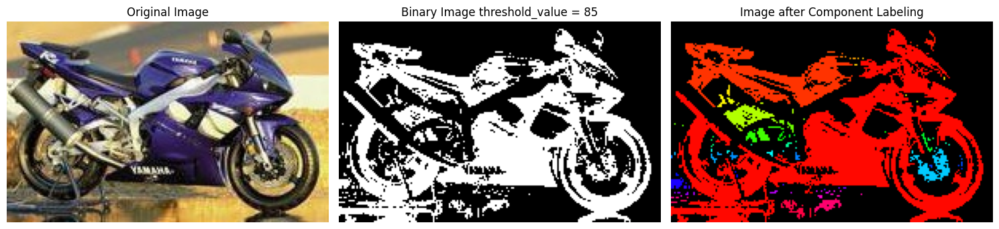

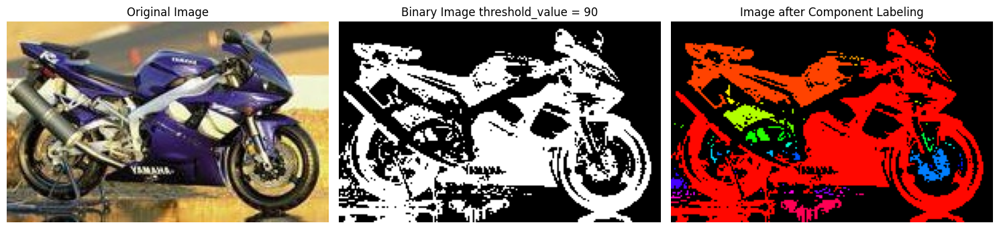

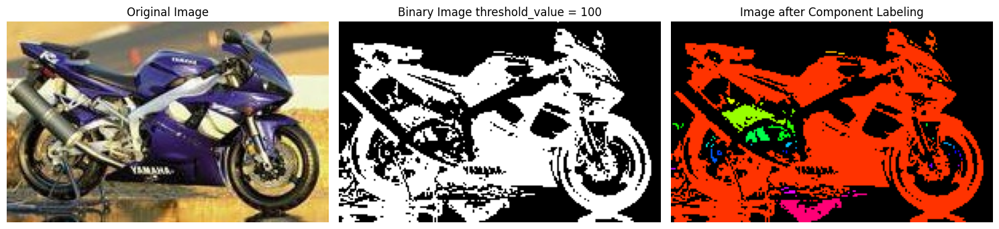

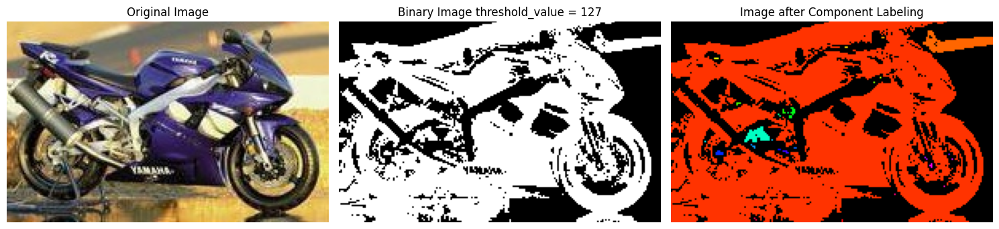

In [ ]:
#Aplico la funcion a alguna de las imagenes
threshold_value = [50,60,65,70,75,80,85,90,100,127]
category = 'motorbike'
index = 77
imagen = imagenes[imagenes.category==category].iloc[index]['path']
for threshold in threshold_value:
  save_path = f'/content/drive/MyDrive/Colab Notebooks/DATA MINING EN CIENCIA Y TECNOLOGIA 2023/TP1/Connected Component Labelling/connected_component_labelling {category}_{threshold}.png'
  connected_component_label(imagen, use_inverted_binary=True, threshold_value=threshold, save_path = None)

###Spectral Clustering

####1. Spectral Clustering

imagen reducida, beta=5, 20 regiones (clusters), eigen_solver = 'amg'

In [ ]:
pip install pyamg

/usr/local/lib/python3.10/dist-packages/sklearn/manifold/_spectral_embedding.py:359: UserWarning: Exited at iteration 20 with accuracies 
[2.99506959e-16 3.17553823e-06 3.12240834e-06 1.08887013e-05
 1.10095904e-05 8.98939188e-06 2.14945894e-05 5.48112723e-05
 2.28612774e-05 3.43421258e-05 2.53210506e-05 2.22024572e-05
 3.22236188e-05 3.81738715e-05 5.78362470e-05 5.28100085e-05
 4.47958441e-05 1.81463918e-04 1.65967453e-04 8.34538660e-04
 1.04631370e-03]
not reaching the requested tolerance 1e-07.
Use iteration 19 instead with accuracy 
0.00010471582843643767.

  _, diffusion_map = lobpcg(laplacian, X, M=M, tol=tol, largest=False)
/usr/local/lib/python3.10/dist-packages/sklearn/manifold/_spectral_embedding.py:359: UserWarning: Exited postprocessing with accuracies 
[9.19883200e-16 6.30439811e-06 5.78301340e-06 1.90094371e-05
 2.58818510e-05 1.86457650e-05 4.10156964e-05 1.11132081e-04
 4.67281560e-05 6.31733843e-05 4.63131780e-05 4.01784388e-05
 5.14915180e-05 6.23238984e-05 1.0015489

Spectral clustering: kmeans, 4.27s


/usr/local/lib/python3.10/dist-packages/sklearn/manifold/_spectral_embedding.py:359: UserWarning: Exited at iteration 20 with accuracies 
[2.40090337e-16 3.17559694e-06 3.12252844e-06 1.08911853e-05
 1.10126408e-05 8.99048816e-06 2.14986573e-05 5.48198605e-05
 2.28654232e-05 3.43467746e-05 2.53240606e-05 2.22039786e-05
 3.22290674e-05 3.81781589e-05 5.78325123e-05 5.28125537e-05
 4.47939245e-05 1.81450317e-04 1.65977373e-04 8.34733903e-04
 1.04627524e-03]
not reaching the requested tolerance 1e-07.
Use iteration 19 instead with accuracy 
0.00010472850221720237.

  _, diffusion_map = lobpcg(laplacian, X, M=M, tol=tol, largest=False)
/usr/local/lib/python3.10/dist-packages/sklearn/manifold/_spectral_embedding.py:359: UserWarning: Exited postprocessing with accuracies 
[9.10587069e-16 6.30429216e-06 5.78338307e-06 1.90119142e-05
 2.58872281e-05 1.86470439e-05 4.10204124e-05 1.11142635e-04
 4.67337062e-05 6.31786368e-05 4.63163038e-05 4.01800493e-05
 5.14962960e-05 6.23272817e-05 1.0015207

Spectral clustering: discretize, 3.41s


/usr/local/lib/python3.10/dist-packages/sklearn/manifold/_spectral_embedding.py:359: UserWarning: Exited at iteration 20 with accuracies 
[2.12390551e-16 3.17549575e-06 3.12228657e-06 1.08864702e-05
 1.10068106e-05 8.98843296e-06 2.14910730e-05 5.48038525e-05
 2.28578037e-05 3.43379458e-05 2.53182995e-05 2.22012275e-05
 3.22188364e-05 3.81707167e-05 5.78380838e-05 5.28087945e-05
 4.47974442e-05 1.81476135e-04 1.65960205e-04 8.34387528e-04
 1.04635047e-03]
not reaching the requested tolerance 1e-07.
Use iteration 19 instead with accuracy 
0.00010470485788486531.

  _, diffusion_map = lobpcg(laplacian, X, M=M, tol=tol, largest=False)
/usr/local/lib/python3.10/dist-packages/sklearn/manifold/_spectral_embedding.py:359: UserWarning: Exited postprocessing with accuracies 
[9.05947761e-16 6.30446443e-06 5.78264270e-06 1.90071716e-05
 2.58770709e-05 1.86446077e-05 4.10117389e-05 1.11123249e-04
 4.67235844e-05 6.31688716e-05 4.63104856e-05 4.01770644e-05
 5.14874823e-05 6.23209844e-05 1.0015481

Spectral clustering: cluster_qr, 5.68s


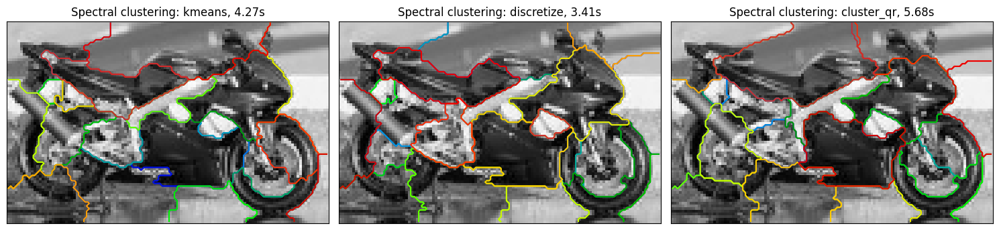

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
from scipy.ndimage import gaussian_filter
from skimage.transform import rescale

from sklearn.cluster import spectral_clustering
from sklearn.feature_extraction import image

category = 'motorbike'
index = 77
path = imagenes[imagenes.category==category].iloc[index]['path']

# Getting the input image in color mode
orig_image = cv2.imread(path)

# orig_image = cv2.cvtColor(orig_image, cv2.COLOR_BGR2RGB)

# # Convert the input image to grayscale
orig_image = cv2.cvtColor(orig_image, cv2.COLOR_BGR2GRAY)

# # Converting those pixels with values 1-127 to 0 and others to 1
# orig_image = cv2.threshold(gray, 70, 255, cv2.THRESH_BINARY_INV)[1]

# Resize it to 20% of the original size to speed up the processing
# Applying a Gaussian filter for smoothing prior to down-scaling
# reduces aliasing artifacts.
#smoothened_img = gaussian_filter(orig_image, sigma=2)
rescaled_img = rescale(orig_image, 0.6, mode="reflect", anti_aliasing=False)

# Convert the image into a graph with the value of the gradient on the
# edges.
graph = image.img_to_graph(rescaled_img)

beta = 5
eps = 1e-6
graph.data = np.exp(-beta * graph.data / graph.data.std()) + eps

n_regions = 20

# Create a single figure with one row and three columns
plt.figure(figsize=(15, 5))

for i, assign_labels in enumerate(("kmeans", "discretize", "cluster_qr"), 1):
    t0 = time.time()
    labels = spectral_clustering(
        graph,
        n_clusters=n_regions,
        eigen_tol=1e-7,
        assign_labels=assign_labels,
        random_state=42,
        eigen_solver='amg'

    )

    t1 = time.time()
    labels = labels.reshape(rescaled_img.shape)

    # Create subplots
    plt.subplot(1, 3, i)

    plt.imshow(rescaled_img, cmap=plt.cm.gray)
    plt.xticks(())
    plt.yticks(())
    title = "Spectral clustering: %s, %.2fs" % (assign_labels, (t1 - t0))
    print(title)
    plt.title(title)

    for l in range(n_regions):
        colors = [plt.cm.nipy_spectral((l + 4) / float(n_regions + 4))]
        plt.contour(labels == l, colors=colors)
        # To view individual segments as appear, comment out plt.pause(0.5)

plt.tight_layout()
#plt.savefig('/content/drive/MyDrive/Colab Notebooks/DATA MINING EN CIENCIA Y TECNOLOGIA 2023/TP1/Spectral Clustering/fig1.png')
plt.show()

####2. Spectral Clustering

imagen sin reducir, beta=5, 15 regiones (clusters), eigen_solver = 'amg'

/usr/local/lib/python3.10/dist-packages/sklearn/manifold/_spectral_embedding.py:359: UserWarning: Exited at iteration 20 with accuracies 
[1.65914673e-16 7.03667165e-06 6.75453596e-06 1.48433014e-05
 9.83801716e-06 2.11083224e-05 3.17843010e-05 2.56435653e-05
 4.13128378e-05 2.09377641e-05 1.26933117e-04 4.02843327e-05
 3.54475899e-05 1.11722837e-04 1.14710947e-04 4.96948535e-04]
not reaching the requested tolerance 1e-07.
Use iteration 20 instead with accuracy 
6.651972956978018e-05.

  _, diffusion_map = lobpcg(laplacian, X, M=M, tol=tol, largest=False)
/usr/local/lib/python3.10/dist-packages/sklearn/manifold/_spectral_embedding.py:359: UserWarning: Exited postprocessing with accuracies 
[8.60908963e-16 7.63764075e-06 7.21516909e-06 1.72850435e-05
 1.11220778e-05 2.39052865e-05 4.28301933e-05 3.26175934e-05
 5.38767243e-05 2.68203187e-05 1.65156094e-04 4.66363124e-05
 3.62044037e-05 1.31189289e-04 1.10551231e-04 3.51268297e-04]
not reaching the requested tolerance 1e-07.
  _, diffusi

Spectral clustering: kmeans, 6.45s


/usr/local/lib/python3.10/dist-packages/sklearn/manifold/_spectral_embedding.py:359: UserWarning: Exited at iteration 20 with accuracies 
[1.71673959e-16 7.03598387e-06 6.75491527e-06 1.48402588e-05
 9.83466890e-06 2.11071752e-05 3.17701254e-05 2.56384246e-05
 4.12796406e-05 2.09278124e-05 1.26847815e-04 4.02818967e-05
 3.54504008e-05 1.11691017e-04 1.14723401e-04 4.97562514e-04]
not reaching the requested tolerance 1e-07.
Use iteration 20 instead with accuracy 
6.653749210652765e-05.

  _, diffusion_map = lobpcg(laplacian, X, M=M, tol=tol, largest=False)
/usr/local/lib/python3.10/dist-packages/sklearn/manifold/_spectral_embedding.py:359: UserWarning: Exited postprocessing with accuracies 
[8.54750925e-16 7.63581585e-06 7.21390472e-06 1.72785419e-05
 1.11184282e-05 2.38996723e-05 4.28154142e-05 3.26157987e-05
 5.38328864e-05 2.68084659e-05 1.65041725e-04 4.66252792e-05
 3.62032277e-05 1.31157972e-04 1.10544455e-04 3.51808287e-04]
not reaching the requested tolerance 1e-07.
  _, diffusi

Spectral clustering: discretize, 8.52s


/usr/local/lib/python3.10/dist-packages/sklearn/manifold/_spectral_embedding.py:359: UserWarning: Exited at iteration 20 with accuracies 
[1.96813119e-16 7.03578725e-06 6.75493091e-06 1.48393046e-05
 9.83344452e-06 2.11066277e-05 3.17655675e-05 2.56355266e-05
 4.12704649e-05 2.09256867e-05 1.26818962e-04 4.02793478e-05
 3.54504851e-05 1.11678631e-04 1.14724752e-04 4.97600862e-04]
not reaching the requested tolerance 1e-07.
Use iteration 20 instead with accuracy 
6.65327021129554e-05.

  _, diffusion_map = lobpcg(laplacian, X, M=M, tol=tol, largest=False)
/usr/local/lib/python3.10/dist-packages/sklearn/manifold/_spectral_embedding.py:359: UserWarning: Exited postprocessing with accuracies 
[8.80538149e-16 7.63539150e-06 7.21358491e-06 1.72769035e-05
 1.11172811e-05 2.38979627e-05 4.28097374e-05 3.26134478e-05
 5.38211548e-05 2.68057663e-05 1.65002372e-04 4.66197010e-05
 3.62021035e-05 1.31143645e-04 1.10542966e-04 3.51821216e-04]
not reaching the requested tolerance 1e-07.
  _, diffusio

Spectral clustering: cluster_qr, 5.53s


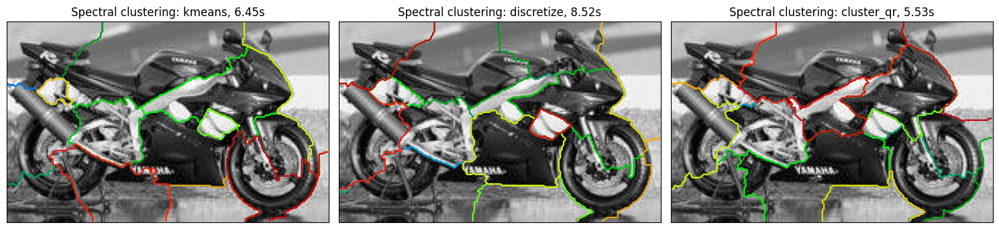

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
from scipy.ndimage import gaussian_filter
from skimage.transform import rescale

from sklearn.cluster import spectral_clustering
from sklearn.feature_extraction import image

category = 'motorbike'
index = 77
path = imagenes[imagenes.category==category].iloc[index]['path']

# Getting the input image in color mode
orig_image = cv2.imread(path)

# orig_image = cv2.cvtColor(orig_image, cv2.COLOR_BGR2RGB)

# # Convert the input image to grayscale
orig_image = cv2.cvtColor(orig_image, cv2.COLOR_BGR2GRAY)

# # Converting those pixels with values 1-127 to 0 and others to 1
# orig_image = cv2.threshold(gray, 70, 255, cv2.THRESH_BINARY_INV)[1]

# Resize it to 20% of the original size to speed up the processing
# Applying a Gaussian filter for smoothing prior to down-scaling
# reduces aliasing artifacts.
#smoothened_img = gaussian_filter(orig_image, sigma=2)
rescaled_img = rescale(orig_image, 1, mode="reflect", anti_aliasing=False)

# Convert the image into a graph with the value of the gradient on the
# edges.
graph = image.img_to_graph(rescaled_img)

beta = 5
eps = 1e-6
graph.data = np.exp(-beta * graph.data / graph.data.std()) + eps

n_regions = 15

# Create a single figure with one row and three columns
plt.figure(figsize=(15, 5))

for i, assign_labels in enumerate(("kmeans", "discretize", "cluster_qr"), 1):
    t0 = time.time()
    labels = spectral_clustering(
        graph,
        n_clusters=n_regions,
        eigen_tol=1e-7,
        assign_labels=assign_labels,
        random_state=42,
        eigen_solver='amg'

    )

    t1 = time.time()
    labels = labels.reshape(rescaled_img.shape)

    # Create subplots
    plt.subplot(1, 3, i)

    plt.imshow(rescaled_img, cmap=plt.cm.gray)
    plt.xticks(())
    plt.yticks(())
    title = "Spectral clustering: %s, %.2fs" % (assign_labels, (t1 - t0))
    print(title)
    plt.title(title)

    for l in range(n_regions):
        colors = [plt.cm.nipy_spectral((l + 4) / float(n_regions + 4))]
        plt.contour(labels == l, colors=colors)
        # To view individual segments as appear, comment out plt.pause(0.5)

plt.tight_layout()
#plt.savefig('/content/drive/MyDrive/Colab Notebooks/DATA MINING EN CIENCIA Y TECNOLOGIA 2023/TP1/Spectral Clustering/fig2.png')
plt.show()


####3. Spectral Clustering

imagen sin reducir, beta=5, 15 regiones (clusters), eigen_solver = 'arpack'

Spectral clustering: kmeans, 99.37s
Spectral clustering: discretize, 92.94s
Spectral clustering: cluster_qr, 94.55s


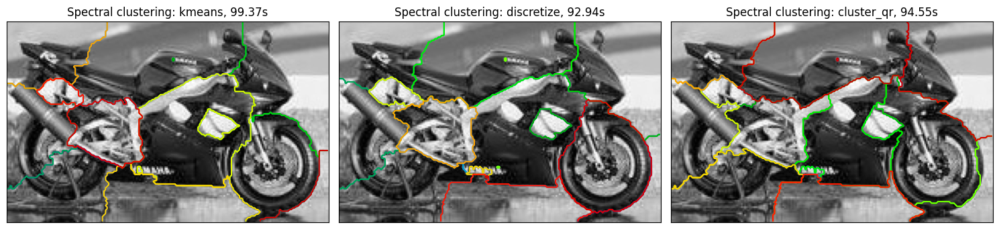

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
from scipy.ndimage import gaussian_filter
from skimage.transform import rescale

from sklearn.cluster import spectral_clustering
from sklearn.feature_extraction import image

category = 'motorbike'
index = 77
path = imagenes[imagenes.category==category].iloc[index]['path']

# Getting the input image in color mode
orig_image = cv2.imread(path)

# orig_image = cv2.cvtColor(orig_image, cv2.COLOR_BGR2RGB)

# # Convert the input image to grayscale
orig_image = cv2.cvtColor(orig_image, cv2.COLOR_BGR2GRAY)

# # Converting those pixels with values 1-127 to 0 and others to 1
# orig_image = cv2.threshold(gray, 70, 255, cv2.THRESH_BINARY_INV)[1]

# Resize it to 20% of the original size to speed up the processing
# Applying a Gaussian filter for smoothing prior to down-scaling
# reduces aliasing artifacts.
#smoothened_img = gaussian_filter(orig_image, sigma=2)
rescaled_img = rescale(orig_image, 1, mode="reflect", anti_aliasing=False)

# Convert the image into a graph with the value of the gradient on the
# edges.
graph = image.img_to_graph(rescaled_img)

beta = 5
eps = 1e-6
graph.data = np.exp(-beta * graph.data / graph.data.std()) + eps

n_regions = 15

# Create a single figure with one row and three columns
plt.figure(figsize=(15, 5))

for i, assign_labels in enumerate(("kmeans", "discretize", "cluster_qr"), 1):
    t0 = time.time()
    labels = spectral_clustering(
        graph,
        n_clusters=n_regions,
        eigen_tol=1e-7,
        assign_labels=assign_labels,
        random_state=42,
        eigen_solver='arpack'

    )

    t1 = time.time()
    labels = labels.reshape(rescaled_img.shape)

    # Create subplots
    plt.subplot(1, 3, i)

    plt.imshow(rescaled_img, cmap=plt.cm.gray)
    plt.xticks(())
    plt.yticks(())
    title = "Spectral clustering: %s, %.2fs" % (assign_labels, (t1 - t0))
    print(title)
    plt.title(title)

    for l in range(n_regions):
        colors = [plt.cm.nipy_spectral((l + 4) / float(n_regions + 4))]
        plt.contour(labels == l, colors=colors)
        # To view individual segments as appear, comment out plt.pause(0.5)

plt.tight_layout()
plt.savefig('/content/drive/MyDrive/Colab Notebooks/DATA MINING EN CIENCIA Y TECNOLOGIA 2023/TP1/Spectral Clustering/fig3.png')
plt.show()


## D. Describir el proceso y comparar los resultados obtenidos

## armado de lista de archivos

In [ ]:
## b.  Cargar imagenes, asociarle su label, calcular tamaño, etc

path_imagenes = 'drive/MyDrive/TP 1 DMCyT 2023/natural_images/'

def get_file_list(path):
    return sorted([os.path.join(path, file)
                   for file in os.listdir(path)
                   if file.endswith('.jpg')])

# Define the image types
image_types = ['airplane', 'car', 'cat', 'dog', 'flower', 'fruit', 'motorbike', 'person']

# Create a dictionary to store the lists of files for each image type
image_files = {}

# Iterate over each image type and get the list of files
for image_type in image_types:
    image_files[image_type] = get_file_list(os.path.join(path_imagenes, image_type))

# Split the filenames for each image type
image_filenames = {image_type: [elemento.split("/")[-1] for elemento in files]
                   for image_type, files in image_files.items()}

#Creo un dataframe
df = pd.DataFrame({'path':[item for sublist in image_files.values() for item in sublist],
          'name':[item for sublist in image_filenames.values() for item in sublist]
 })

#Agrego una columna category
df['category'] = df['name'].apply(lambda x: x.split('_')[0])

print(df)

# List of image paths
image_paths = list(df['path'])

# Process images and extract shapes using NumPy
image_shapes = []
for image_path in image_paths:
    image = Image.open(image_path)
    image_array = np.array(image)
    shape = image_array.shape
    image_shapes.append(shape)

df['size'] = image_shapes

print(df)

#Guardo un dataframe para no tener que generarlo de nuevo, demora "bastante" (15-20')
df.to_csv('/content/drive/MyDrive/Colab Notebooks/DATA MINING EN CIENCIA Y TECNOLOGIA 2023/TP1/TP1_procesado.csv', index= False)
#df.to_csv('TP1_procesado.csv', index= False)

## c. Cargo directamente el df procesado para que sea mas rapido

df = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/DATA MINING EN CIENCIA Y TECNOLOGIA 2023/TP1/TP1_procesado.csv')

## d. Pre-procesamiento

#Variabilidad en el tamaño de las imagenes (tener en cuenta para luego trabajarlas)
df_size_category = df.groupby('category')['size'].value_counts().reset_index(name='count').sort_values(by= 'count', ascending = False)
print(df_size_category)

#Cuantas imagenes son mas grandes que lo que necesita la CNN
filtro = df[df['size'] >= '(224, 224, 3)']
cantidad = len(filtro)
print(f'Imagenes mayores a (224, 224) = {cantidad}')